In [2]:
%matplotlib notebook

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib

import time
import pickle

import memory_profiler
%load_ext memory_profiler

from pathlib import Path

In [3]:
import pygam

pygam.__version__

'0.8.0'

In [5]:
%load_ext autoreload
%autoreload 2

from pubmed_landscape_src.metrics import counts_and_fraction_words_in_red_squares
from pubmed_landscape_src.gam import *
from pubmed_landscape_src.plotting import (
    plot_tsne_zoom,
    plot_square,
    plot_region_numbers,
    plot_region_names,
    improved_coloring,
    plot_tsne_colors,
    plot_ml_label_tags,
)
from pubmed_landscape_src.exploration import (
    find_mask_words,
    print_tfidf_top_words,
    print_tfidf_threshold_words,
)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [6]:
import black
import jupyter_black

jupyter_black.load(line_length=79)

In [5]:
variables_path = Path("../results/variables")
figures_path = Path("../results/figures")
berenslab_data_path = Path("/gpfs01/berens/data/data/pubmed_processed")

In [5]:
plt.style.use("matplotlib_style.txt")

# Import data

In [12]:
# import clean_df_updated
clean_df_updated_reparsed_filtered_with_authors_ISSN = pd.read_pickle(
    variables_path / "clean_df_updated_reparsed_filtered_with_authors_ISSN"
)

tcmalloc: large alloc 1073741824 bytes == 0x8c1924000 @ 
tcmalloc: large alloc 1233903616 bytes == 0x96b89c000 @ 


In [13]:
tsne_reparsed = np.load(variables_path / "bert/tsne_reparsed.npy")

In [14]:
# load
tfidf_features_updated_reparsed = sp.sparse.load_npz(
    variables_path / "tfidf_features_updated_reparsed.npz"
)

# legend colors
pickle_in = open(variables_path / "vocabulary_updated_reparsed.pkl", "rb")
vocabulary_updated_reparsed = pickle.load(pickle_in)

tcmalloc: large alloc 18038185984 bytes == 0x96b89c000 @ 
tcmalloc: large alloc 18038185984 bytes == 0xde93f0000 @ 


In [15]:
# define vocabulary swap
vocabulary_swap = {
    value: key for key, value in vocabulary_updated_reparsed.items()
}

In [16]:
all_abstracts = clean_df_updated_reparsed_filtered_with_authors_ISSN["AbstractText"]

# Color the embedding by presence of ML mehtods

ML and statistical methods:
- random forest
- neural network
- convolutional
- linear regression
- clustering
- dimensionality reduction
- support vector
- factor analysis
- principal component analysis
- deep learning

## Create colors

In [15]:
# manually-picked words
ml_words = [
    "random forest",
    "neural network",
    "convolutional",
    "linear regression",
    "clustering",
    "dimensionality reduction",
    "support vector",
    "factor analysis",
    "principal component analysis",
    "deep learning",
]

In [16]:
# manually-picked colors
ml_colors = [
    "#008941",
    "#1CE6FF",
    "#FF34FF",
    "#FF4A46",
    "#006FA6",
    "#A30059",
    "#0000A6",
    "#63FFAC",
    "#7A4900",
    "#FFB500",
]

In [17]:
ml_legend = dict(zip(ml_words, ml_colors))

In [10]:
%%time
ml_labels, ml_colors = improved_coloring(clean_df_updated_reparsed_filtered_with_authors_ISSN['AbstractText'], ml_legend)

tcmalloc: large alloc 2647957504 bytes == 0x9632bc000 @ 
tcmalloc: large alloc 2647957504 bytes == 0xa524f2000 @ 
tcmalloc: large alloc 2647957504 bytes == 0x94593c000 @ 
tcmalloc: large alloc 2647957504 bytes == 0xa524f2000 @ 
tcmalloc: large alloc 2647957504 bytes == 0x94593c000 @ 
tcmalloc: large alloc 2647957504 bytes == 0xa524f2000 @ 


CPU times: user 11min 40s, sys: 1min 15s, total: 12min 56s
Wall time: 12min 54s


In [11]:
# save results
np.save(variables_path / "ml_colors", ml_colors)

# save results
f = open(variables_path / "ml_legend.pkl","wb")
pickle.dump(ml_legend,f)
f.close()

In [23]:
# #load
# ml_colors = np.load(variables_path / "ml_colors.npy", allow_pickle=True)

# pickle_in = open(variables_path / "ml_legend.pkl","rb")
# ml_legend = pickle.load(pickle_in)

## Plot

In [20]:
labels_abbrv = {
    "random forest": "RF",
    "neural network": "NN",
    "convolutional": "CNN",
    "linear regression": "LR",
    "clustering": "Clustering",
    "dimensionality reduction": "DR",
    "support vector": "SVM",
    "factor analysis": "FA",
    "principal component analysis": "PCA",
    "deep learning": "DL",
}
print(ml_legend.keys())

dict_keys(['random forest', 'neural network', 'convolutional', 'linear regression', 'clustering', 'dimensionality reduction', 'support vector', 'factor analysis', 'principal component analysis', 'deep learning'])


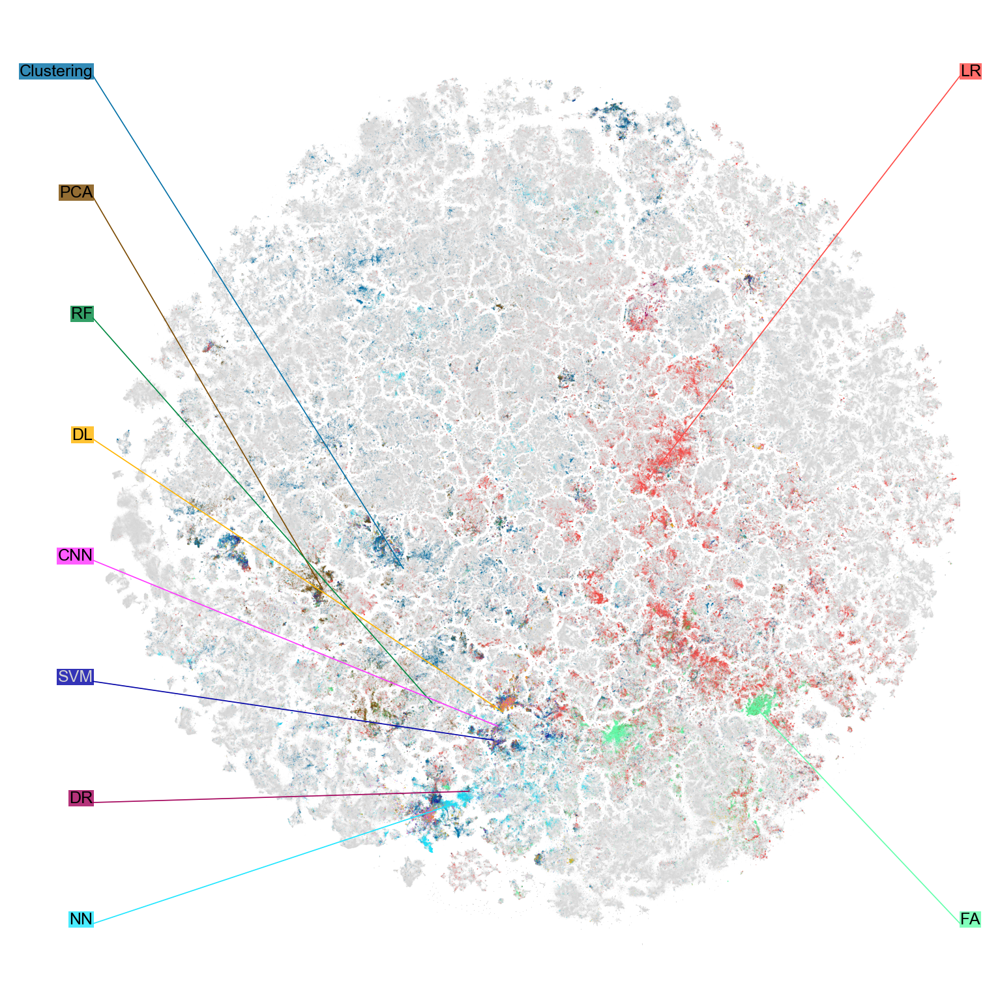

In [22]:
%matplotlib inline
fig, ax0 = plt.subplots(figsize=(5, 5), dpi=300, layout="constrained")
tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

txtkwargs = dict(size=8, weight="bold", va="top", ha="left")

# subplot a
x_lim = (-230, 220)  # (-220,220)
y_lim = (-220, 220)

plot_tsne_colors(
    tsne,
    ml_colors,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax0,
    plot_type=None,
    axis_on=False,
)
plot_ml_label_tags(
    tsne,
    ml_colors,
    ml_legend,
    abbrv=labels_abbrv,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax0,
    fontsize=6,
)

# fig.savefig(figures_path / 'tsne_machine_learning_methods.png')

#  Papers containing 'machine learning' in their abstracts

In [17]:
mask_machine_learning = find_mask_words(
    all_abstracts, "machine learning", verbose=True
)

Number of papers with uncapitalized word 'machine learning':  36692
Number of papers with capitalized word 'machine learning':  3849
Number of total papers with word 'machine learning':  38446


In [761]:
np.save(variables_path / "mask_machine_learning", mask_machine_learning)

Number of papers with uncapitalized word 'machine learning':  36692
Number of papers with capitalized word 'machine learning':  3849
Number of total papers with word 'machine learning':  38446
CPU times: user 58.5 s, sys: 7.46 s, total: 1min 5s
Wall time: 1min 6s


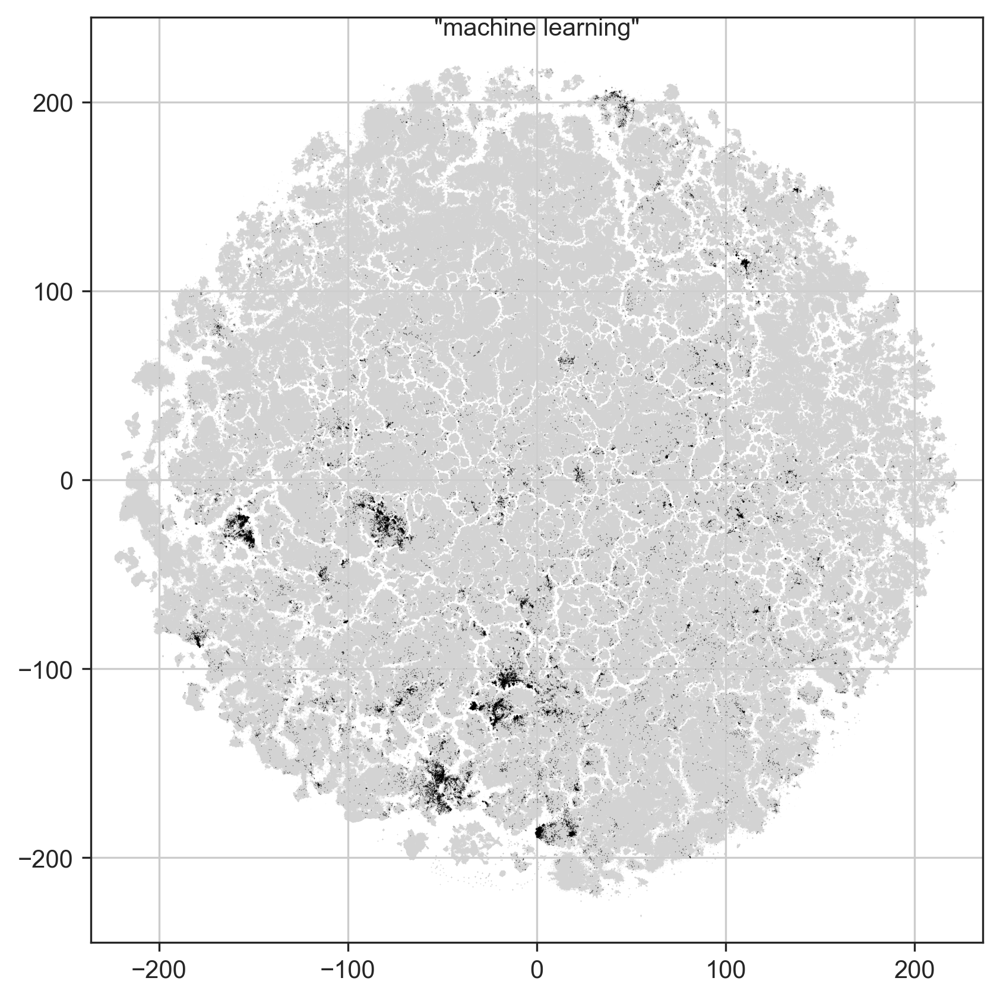

In [20]:
%%time
%matplotlib inline

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

x_lim = (-230, 230)
y_lim = (-230, 230)

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")
plot_tsne_word(
    all_abstracts,
    "machine learning",
    tsne,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    title_on=True,
    axis_on=True,
)
ax.grid()
# fig.savefig(figures_path / 'tsne_machine_learning.png')

## Manual exploration of different regions

### Region 1: eeg signals

CPU times: user 515 ms, sys: 776 µs, total: 516 ms
Wall time: 515 ms


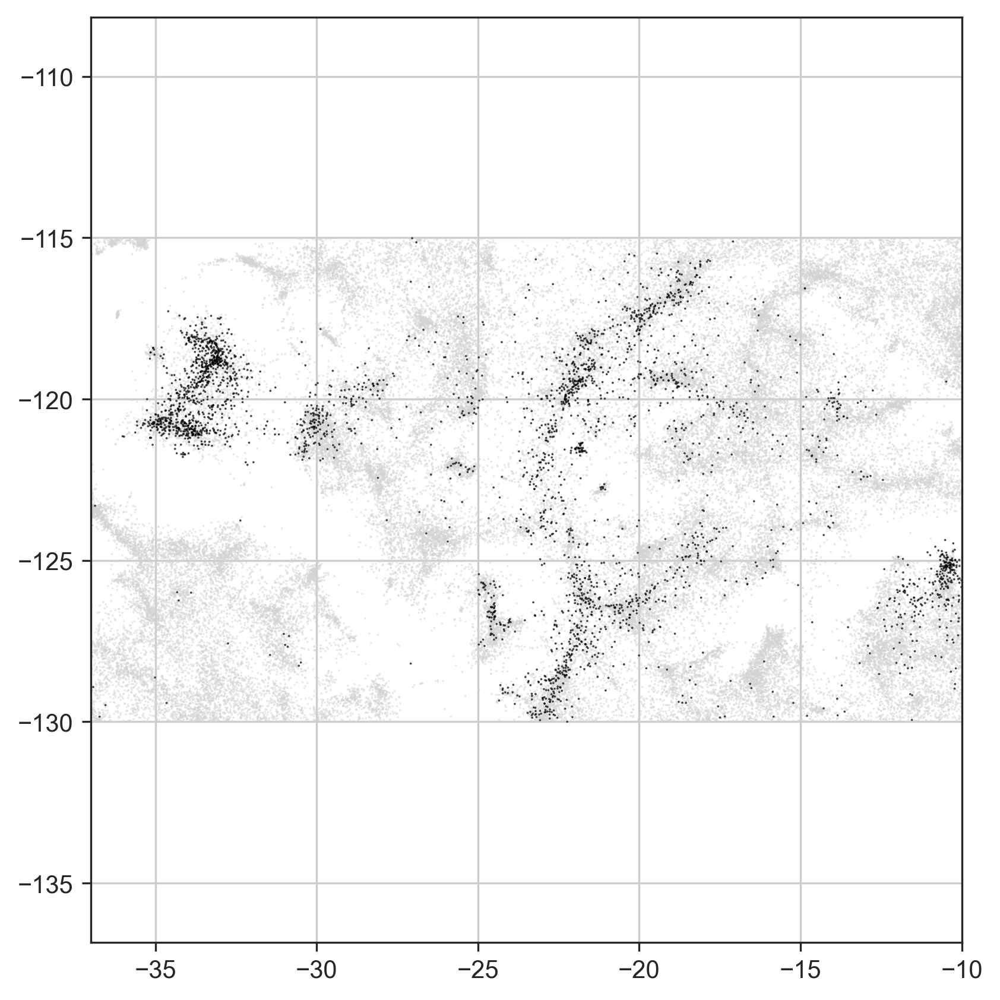

In [42]:
%%time
%matplotlib inline

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

right = -10
left = -37
top = -115
bottom = -130

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")
plot_tsne_zoom(
    tsne,
    mask_machine_learning,
    x_lim=(left, right),
    y_lim=(bottom, top),
    ax=ax,
    plot_type=None,
    axis_on=True,
)

In [19]:
#mask island 1
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=-10
left=-37
top=-115
bottom=-130
mask_region_8=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom)

In [20]:
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_8, 20)

There are 66061 papers.
TF-IDF:  [0.04745359 0.04063199 0.03729748 0.034564   0.0310839  0.02819208
 0.02766144 0.02405077 0.02375497 0.02310898 0.02310709 0.02269765
 0.02265905 0.02263826 0.02223701 0.0218513  0.02086854 0.02011302
 0.02004923 0.01981833]
Words:  ['the' 'of' 'and' 'to' 'in' 'for' 'is' 'eeg' 'this' 'on' 'with' 'hearing'
 'data' 'signals' 'that' 'based' 'are' 'performance' 'we' 'method']


In [21]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_8, 20)

For threshold = 0.05 ['the' 'paper' 'performance' 'proposed' 'data' 'signals' 'accuracy'
 'based' 'method' 'signal' 'system' 'subjects' 'brain' 'can' 'of' 'we'
 'time' 'classification' 'using' 'algorithm']
For threshold = 0.10 ['eeg' 'signals' 'hearing' 'classification' 'signal' 'speech' 'noise'
 'cochlear' 'algorithm' 'proposed' 'brain' 'accuracy' 'system' 'ecg'
 'method' 'motor' 'movement' 'bci' 'performance' 'learning']


In [22]:
#mask island 1
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=-10
left=-37
top=-115
bottom=-130
mask_region_8_with_ml=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) & mask_machine_learning

In [23]:
%%time
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_8_with_ml, 20)

There are 3088 papers.
TF-IDF:  [0.11973793 0.10463059 0.04878839 0.0455792  0.04315616 0.04083293
 0.03989912 0.03790121 0.03558707 0.03390402 0.03389927 0.03373505
 0.03217053 0.0313815  0.03073611 0.0294592  0.02911542 0.02905263
 0.02890477 0.02883561]
Words:  ['machine' 'learning' 'classification' 'the' 'accuracy' 'data' 'of' 'and'
 'to' 'algorithms' 'based' 'features' 'performance' 'for' 'in' 'proposed'
 'is' 'we' 'using' 'feature']
CPU times: user 168 ms, sys: 10.8 ms, total: 179 ms
Wall time: 175 ms


In [ ]:
%%time
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_8_with_ml, 20)

For threshold = 0.05 ['machine' 'learning' 'accuracy' 'classification' 'data' 'performance'
 'features' 'based' 'proposed' 'algorithms' 'the' 'methods' 'feature'
 'models' 'paper' 'model' 'neural' 'using' 'algorithm' 'prediction']
For threshold = 0.10 ['machine' 'learning' 'classification' 'accuracy' 'algorithms' 'features'
 'eeg' 'classifier' 'feature' 'classifiers' 'prediction' 'proposed'
 'dataset' 'svm' 'signals' 'algorithm' 'models' 'wearable' 'performance'
 'neural']
CPU times: user 424 ms, sys: 30.2 ms, total: 455 ms
Wall time: 452 ms


### Region 2: sequencing

CPU times: user 545 ms, sys: 90 µs, total: 545 ms
Wall time: 545 ms


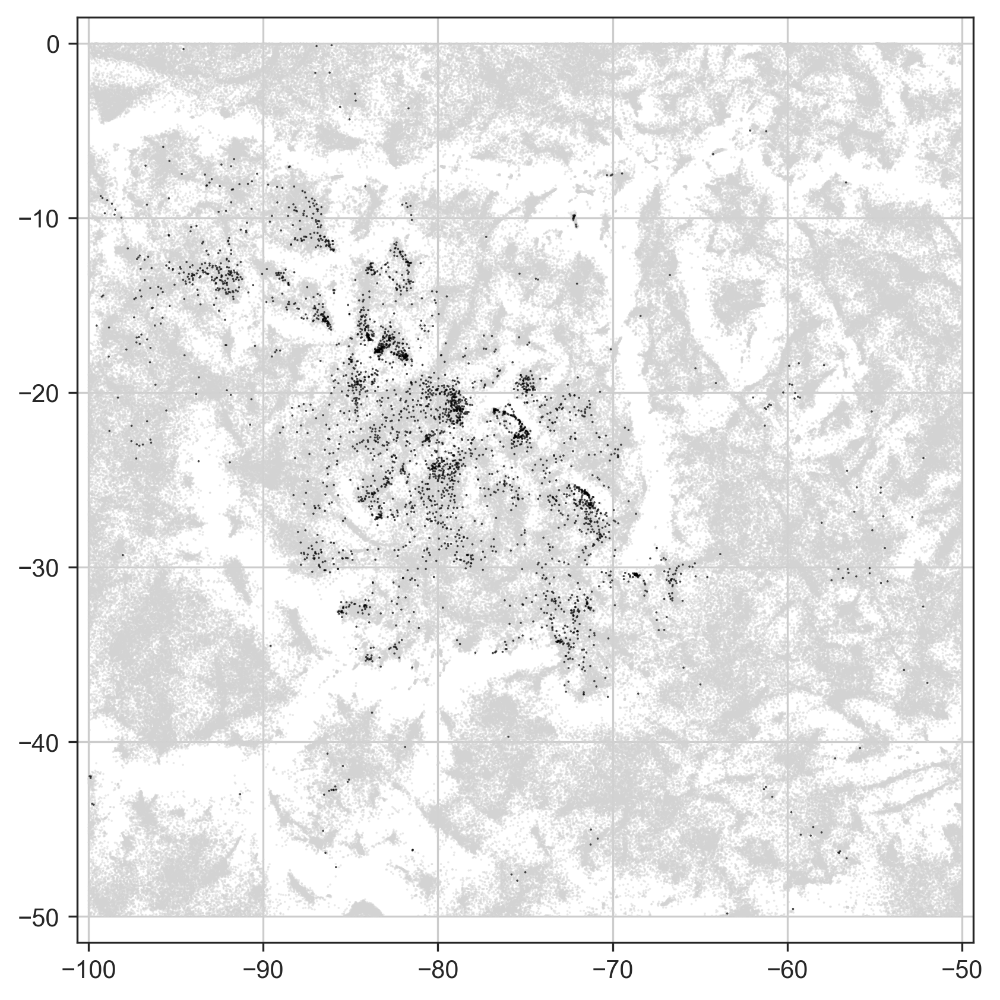

In [34]:
%%time
%matplotlib inline

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

right = -50
left = -100
top = 0
bottom = -50

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")
plot_tsne_zoom(
    tsne,
    mask_machine_learning,
    x_lim=(left, right),
    y_lim=(bottom, top),
    ax=ax,
    plot_type=None,
    axis_on=True,
)

CPU times: user 425 ms, sys: 3.84 ms, total: 429 ms
Wall time: 429 ms


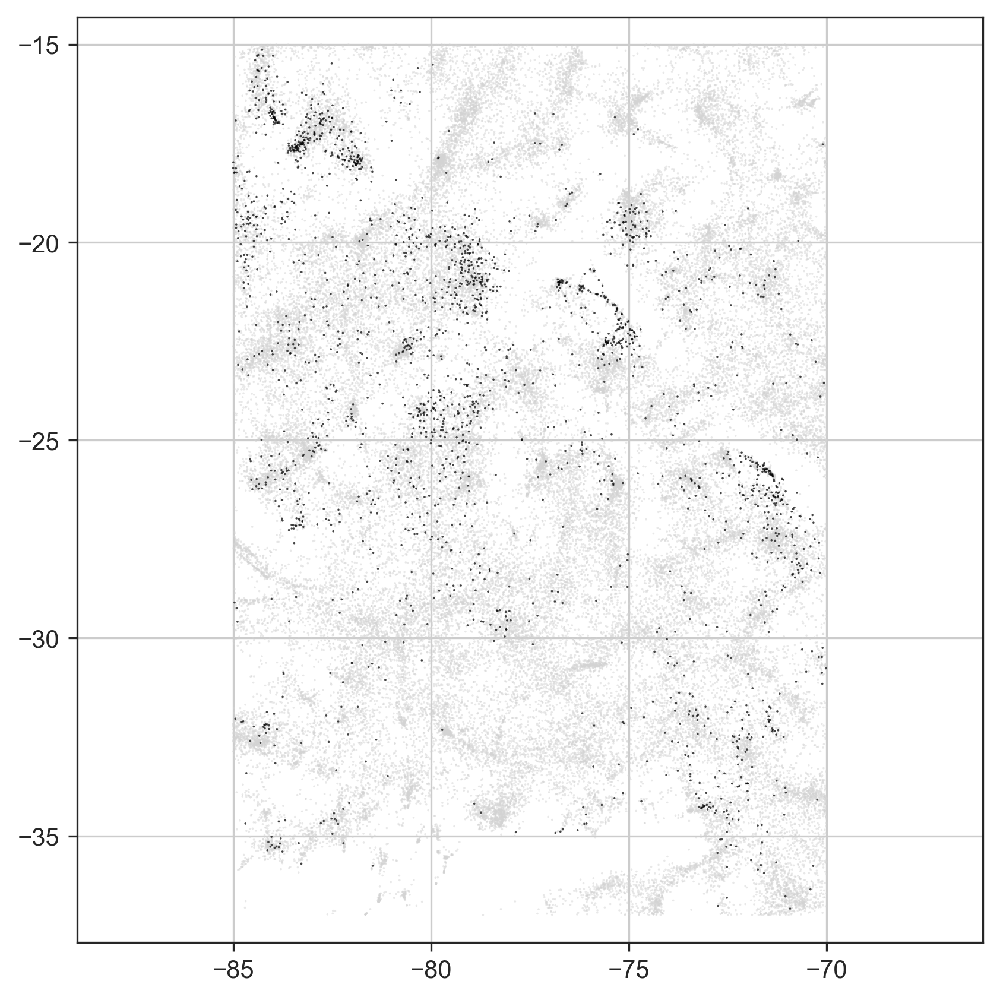

In [35]:
%%time
%matplotlib inline

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

right = -70
left = -85
top = -15
bottom = -37

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")
plot_tsne_zoom(
    tsne,
    mask_machine_learning,
    x_lim=(left, right),
    y_lim=(bottom, top),
    ax=ax,
    plot_type=None,
    axis_on=True,
)

In [168]:
#mask island 1
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=-70
left=-85
top=-15
bottom=-37
mask_region_2=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom)

In [170]:
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_2, 20)

There are 64849 papers.
TF-IDF:  [0.04344401 0.0419793  0.03946391 0.03700189 0.0331943  0.03311613
 0.03311585 0.02946626 0.02908298 0.02901251 0.0286073  0.02841626
 0.02819295 0.02633209 0.02483159 0.02400613 0.022993   0.02267424
 0.02263982 0.02252815]
Words:  ['data' 'the' 'of' 'and' 'we' 'gene' 'to' 'for' 'genome' 'in' 'genes'
 'available' 'is' 'are' 'http' 'sequencing' 'that' 'analysis' 'can'
 'methods']


In [195]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_2, 20)

For threshold = 0.05 ['data' 'available' 'gene' 'genome' 'genes' 'http' 'we' 'sequencing'
 'methods' 'biological' 'the' 'information' 'analysis' 'sequence' 'tools'
 'based' 'database' 'genomic' 'can' 'method']
For threshold = 0.10 ['gene' 'genome' 'genes' 'sequencing' 'network' 'database' 'http'
 'networks' 'datasets' 'data' 'genomic' 'sequences' 'genomes' 'sequence'
 'annotation' 'github' 'biological' 'tools' 'microarray' 'expression']


In [38]:
#mask island 1
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=-70
left=-100
top=-5
bottom=-37
mask_region_2_with_ml=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) & mask_machine_learning

In [39]:
%%time
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_2_with_ml, 20)

There are 2925 papers.
TF-IDF:  [0.11071144 0.09857728 0.04384727 0.04207924 0.04002604 0.039133
 0.03875643 0.03786277 0.03703189 0.03506009 0.03147953 0.03107055
 0.03069238 0.02753519 0.02589498 0.02558283 0.02494988 0.02455347
 0.02452337 0.02448303]
Words:  ['machine' 'learning' 'data' 'the' 'of' 'methods' 'we' 'and' 'prediction'
 'to' 'based' 'in' 'for' 'is' 'are' 'gene' 'can' 'that' 'algorithms' 'on']
CPU times: user 287 ms, sys: 87.7 ms, total: 375 ms
Wall time: 372 ms


In [40]:
%%time
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_2_with_ml, 20)

For threshold = 0.05 ['machine' 'learning' 'data' 'methods' 'prediction' 'we' 'based'
 'computational' 'biological' 'models' 'features' 'accuracy' 'algorithms'
 'gene' 'approaches' 'classification' 'predict' 'available' 'method'
 'network']
For threshold = 0.10 ['machine' 'learning' 'prediction' 'drug' 'methods' 'classification'
 'datasets' 'algorithms' 'network' 'genes' 'gene' 'cancer' 'computational'
 'models' 'features' 'feature' 'data' 'networks' 'biological' 'github']
CPU times: user 532 ms, sys: 44.8 ms, total: 577 ms
Wall time: 572 ms


### Region 3: image segmentation

CPU times: user 525 ms, sys: 6.83 ms, total: 532 ms
Wall time: 530 ms


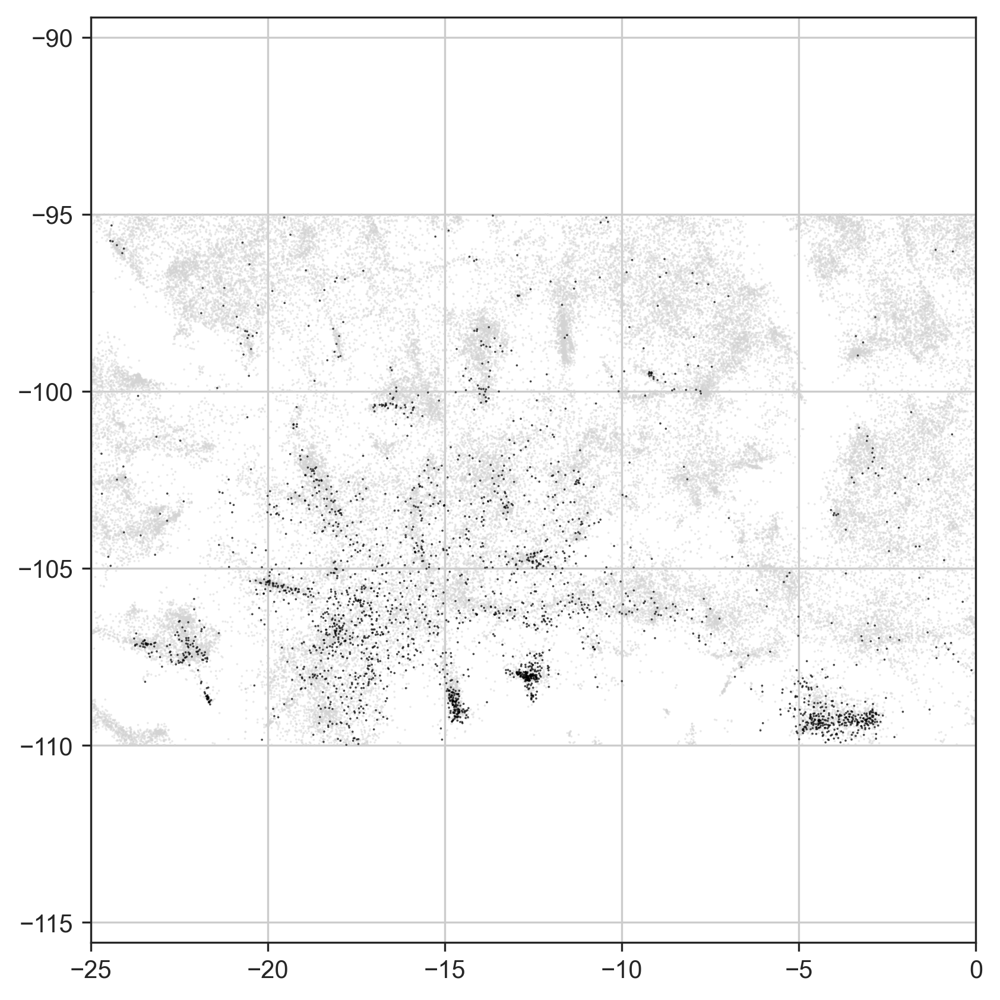

In [43]:
%%time
%matplotlib inline

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

right = 0
left = -25
top = -95
bottom = -110

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")
plot_tsne_zoom(
    tsne,
    mask_machine_learning,
    x_lim=(left, right),
    y_lim=(bottom, top),
    ax=ax,
    plot_type=None,
    axis_on=True,
)

In [28]:
#mask island 1
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=0
left=-25
top=-95
bottom=-110
mask_region_9=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom)

In [29]:
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_9, 20)

There are 62050 papers.
TF-IDF:  [0.05705307 0.0516928  0.04744707 0.04059505 0.03935512 0.03721463
 0.03519002 0.03393136 0.03114972 0.03093993 0.02972058 0.02859774
 0.02774905 0.02727869 0.0254196  0.02445024 0.02355888 0.02348661
 0.02293686 0.02289569]
Words:  ['images' 'image' 'the' 'of' 'segmentation' 'and' 'method' 'to' 'in' 'is'
 'for' 'imaging' 'proposed' 'based' 'algorithm' 'on' 'using' 'this' 'we'
 'accuracy']


In [30]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_9, 20)

For threshold = 0.05 ['images' 'image' 'the' 'method' 'imaging' 'proposed' 'accuracy' 'based'
 'paper' 'algorithm' 'segmentation' 'data' 'methods' 'model' 'using'
 'performance' 'mri' 'we' 'brain' 'approach']
For threshold = 0.10 ['images' 'image' 'segmentation' 'algorithm' 'method' 'proposed' 'mri'
 '3d' 'imaging' 'ct' 'registration' 'accuracy' 'brain' 'reconstruction'
 'classification' 'automatic' 'learning' 'phantom' 'diffusion' 'noise']


In [31]:
#mask island 1
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=0
left=-25
top=-95
bottom=-110
mask_region_9_with_ml=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) & mask_machine_learning

In [32]:
%%time
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_9_with_ml, 20)

There are 2327 papers.
TF-IDF:  [0.11250337 0.11107414 0.0593862  0.05138996 0.049071   0.04451096
 0.04107219 0.03992233 0.0393587  0.03868945 0.03820883 0.03457098
 0.03427157 0.03399698 0.03241195 0.03090504 0.03079942 0.02928901
 0.02927642 0.02918841]
Words:  ['machine' 'learning' 'images' 'image' 'classification' 'the'
 'segmentation' 'of' 'accuracy' 'and' 'deep' 'features' 'to' 'based' 'for'
 'in' 'algorithms' 'performance' 'is' 'methods']
CPU times: user 229 ms, sys: 4.08 ms, total: 233 ms
Wall time: 228 ms


In [33]:
%%time
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_9_with_ml, 20)

For threshold = 0.05 ['machine' 'learning' 'images' 'image' 'classification' 'accuracy' 'deep'
 'features' 'performance' 'neural' 'based' 'proposed' 'imaging' 'methods'
 'algorithms' 'data' 'network' 'feature' 'method' 'diagnosis']
For threshold = 0.10 ['learning' 'machine' 'images' 'image' 'classification' 'segmentation'
 'deep' 'features' 'convolutional' 'accuracy' 'algorithms' 'cnn' 'feature'
 'dataset' 'classifier' 'classifiers' 'proposed' 'mri' 'ad' 'svm']
CPU times: user 329 ms, sys: 27 ms, total: 356 ms
Wall time: 352 ms


### Region 4: ML algorithms

CPU times: user 513 ms, sys: 5.12 ms, total: 518 ms
Wall time: 518 ms


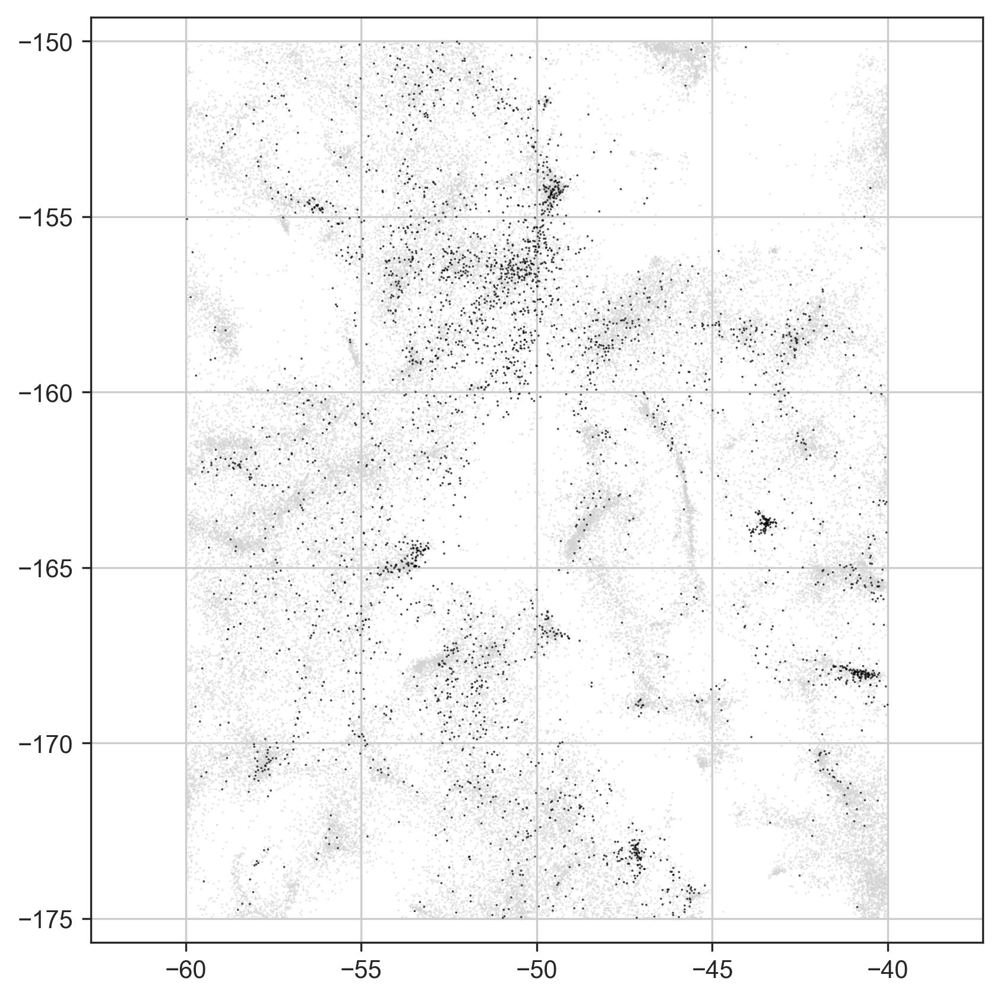

In [41]:
%%time
%matplotlib inline

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

right = -40
left = -60
top = -150
bottom = -175

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")
plot_tsne_zoom(
    tsne,
    mask_machine_learning,
    x_lim=(left, right),
    y_lim=(bottom, top),
    ax=ax,
    plot_type=None,
    axis_on=True,
)

In [11]:
#mask island 1
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=-40
left=-60
top=-150
bottom=-175
mask_region_7=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom)

In [12]:
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_7, 20)

There are 60682 papers.
TF-IDF:  [0.04760557 0.03917773 0.0384168  0.03474478 0.03409043 0.0340095
 0.03365257 0.03184181 0.0311545  0.0300089  0.02979527 0.02837387
 0.02837198 0.02717509 0.02715785 0.02670755 0.0266326  0.0261329
 0.0259385  0.02583877]
Words:  ['the' 'of' 'proposed' 'and' 'is' 'algorithm' 'to' 'network' 'paper' 'we'
 'in' 'based' 'learning' 'method' 'data' 'networks' 'for' 'on' 'this'
 'are']


In [13]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_7, 20)

For threshold = 0.05 ['proposed' 'paper' 'the' 'algorithm' 'network' 'we' 'method' 'data'
 'based' 'learning' 'performance' 'propose' 'problem' 'model' 'real'
 'networks' 'methods' 'can' 'approach' 'neural']
For threshold = 0.10 ['algorithm' 'network' 'proposed' 'learning' 'networks' 'algorithms'
 'problem' 'method' 'neural' 'classification' 'image' 'feature' 'model'
 'optimization' 'framework' 'accuracy' 'data' 'real' 'graph' 'datasets']


In [14]:
#mask island 1
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=-40
left=-60
top=-150
bottom=-175
mask_region_7_with_ml=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) & mask_machine_learning

In [15]:
%%time
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_7_with_ml, 20)

There are 3175 papers.
TF-IDF:  [0.11478969 0.11215312 0.0456844  0.04309053 0.03874629 0.03844481
 0.0365164  0.0361191  0.03530925 0.03408928 0.03291821 0.03278037
 0.03191496 0.03139299 0.03005636 0.02874894 0.0285952  0.02822893
 0.02777105 0.02721822]
Words:  ['learning' 'machine' 'the' 'data' 'of' 'algorithms' 'classification'
 'and' 'proposed' 'to' 'is' 'algorithm' 'we' 'in' 'based' 'paper'
 'methods' 'performance' 'for' 'on']
CPU times: user 231 ms, sys: 2 ms, total: 233 ms
Wall time: 230 ms


In [16]:
%%time
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_7_with_ml, 20)

For threshold = 0.05 ['machine' 'learning' 'data' 'proposed' 'paper' 'algorithms'
 'classification' 'performance' 'algorithm' 'the' 'methods' 'accuracy'
 'we' 'based' 'network' 'neural' 'models' 'propose' 'model' 'problem']
For threshold = 0.10 ['learning' 'machine' 'algorithms' 'classification' 'algorithm' 'proposed'
 'network' 'feature' 'networks' 'neural' 'datasets' 'training' 'deep'
 'data' 'classifiers' 'models' 'accuracy' 'classifier' 'features'
 'methods']
CPU times: user 388 ms, sys: 37.3 ms, total: 425 ms
Wall time: 423 ms


### Region 5: mass spectometry

CPU times: user 539 ms, sys: 3.02 ms, total: 542 ms
Wall time: 542 ms


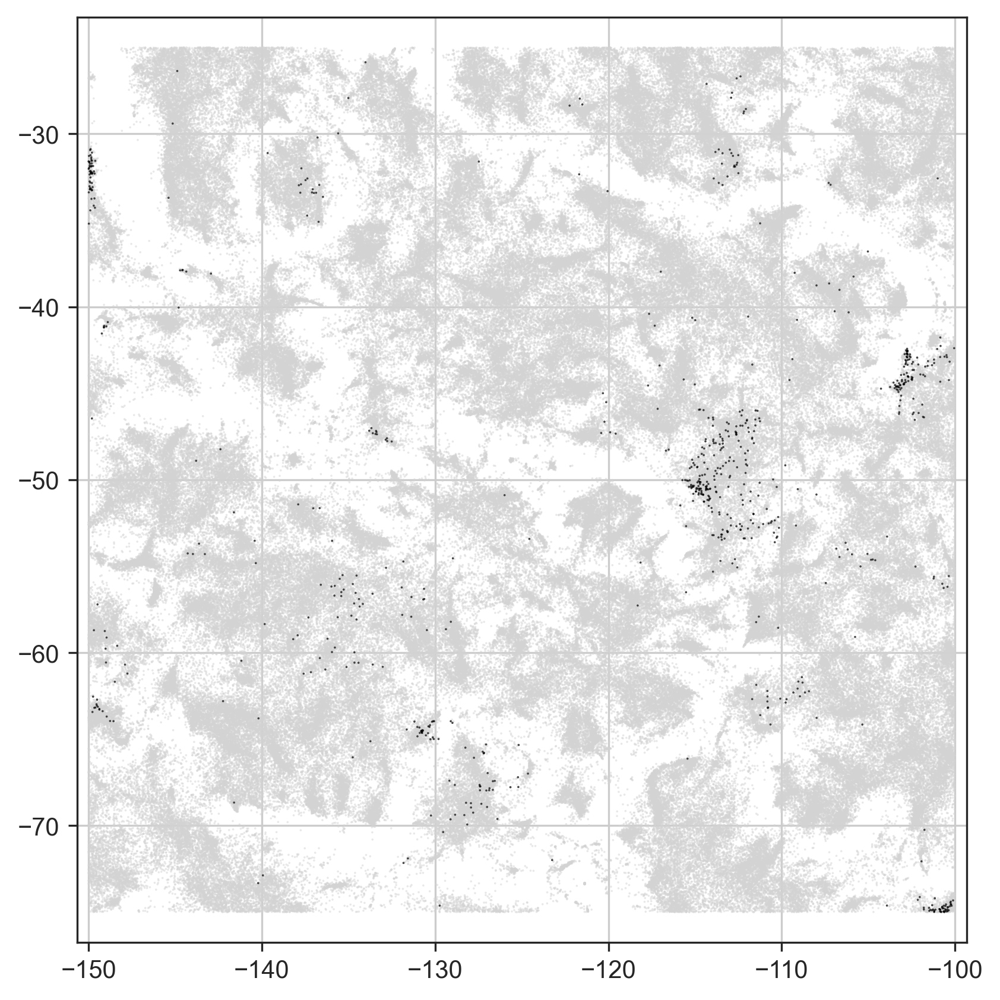

In [51]:
%%time
%matplotlib inline

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

right = -100
left = -150
top = -25
bottom = -75

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")
plot_tsne_zoom(
    tsne,
    mask_machine_learning,
    x_lim=(left, right),
    y_lim=(bottom, top),
    ax=ax,
    plot_type=None,
    axis_on=True,
)

CPU times: user 518 ms, sys: 8.83 ms, total: 527 ms
Wall time: 527 ms


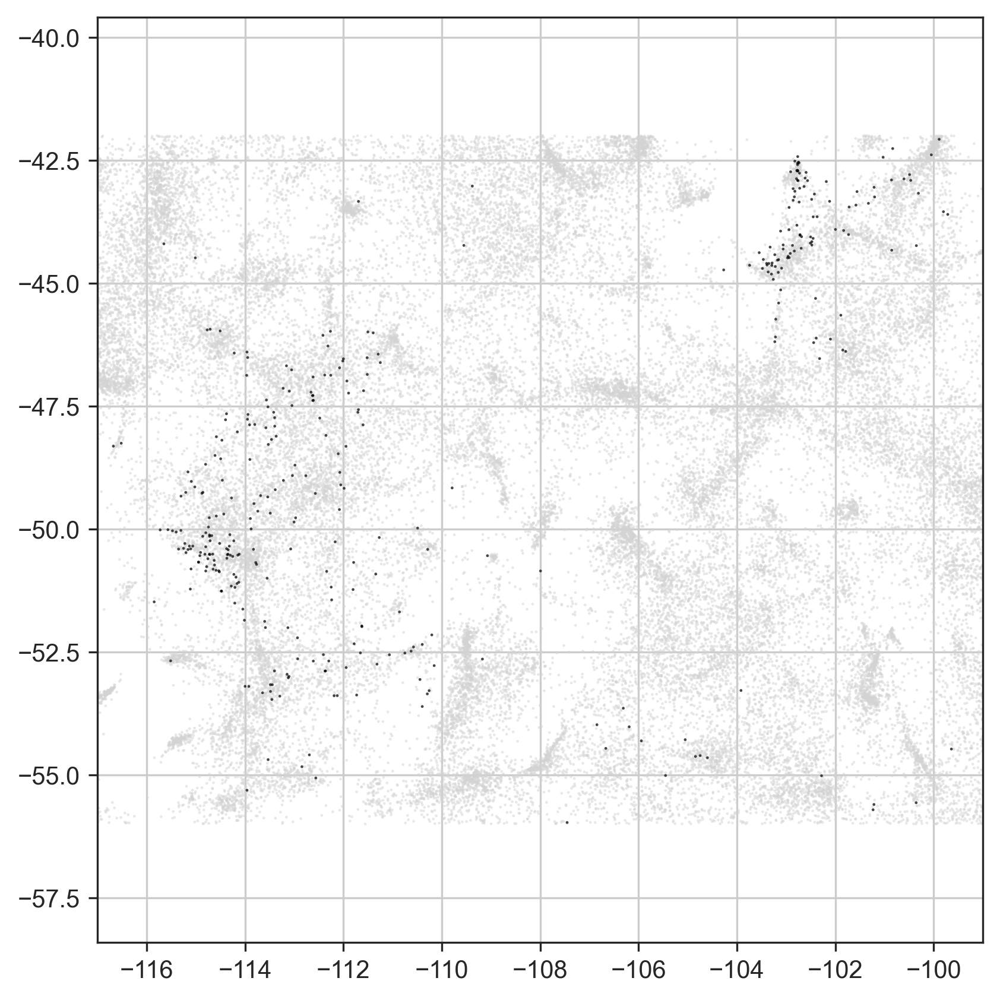

In [53]:
%%time
%matplotlib inline

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

right = -99
left = -117
top = -42
bottom = -56

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")
plot_tsne_zoom(
    tsne,
    mask_machine_learning,
    x_lim=(left, right),
    y_lim=(bottom, top),
    ax=ax,
    plot_type="zoom x2",
    axis_on=True,
)

In [235]:
#mask island 1
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=-99
left=-117
top=-42
bottom=-56
mask_region_12=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom)

In [236]:
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_12, 20)

There are 45030 papers.
TF-IDF:  [0.04742168 0.0441458  0.04129052 0.04045862 0.03808278 0.03572661
 0.03496958 0.03036222 0.0291708  0.02914295 0.02808521 0.02785309
 0.0278225  0.02463857 0.02297919 0.02243727 0.02231376 0.0215372
 0.02106573 0.02093982]
Words:  ['ms' 'the' 'of' 'mass' 'and' 'spectrometry' 'method' 'in' 'for' 'to'
 'analysis' 'chromatography' 'samples' 'compounds' 'were' 'was' 'spectra'
 'by' 'liquid' 'with']


In [237]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_12, 20)

For threshold = 0.05 ['mass' 'spectrometry' 'ms' 'method' 'chromatography' 'samples'
 'compounds' 'liquid' 'analysis' 'the' 'detection' 'spectra' 'sample'
 'ion' 'ionization' 'analytical' 'methods' 'determination' 'extraction'
 'applied']
For threshold = 0.10 ['ms' 'mass' 'spectrometry' 'spectra' 'method' 'compounds' 'lc'
 'ionization' 'ion' 'metabolites' 'samples' 'chromatography' 'gc' 'hplc'
 'extraction' 'ions' 'maldi' 'esi' 'quantification' 'liquid']


In [245]:
#mask island 1
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=-99
left=-117
top=-42
bottom=-56
mask_region_12_ml=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) & mask_machine_learning

In [239]:
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_12_ml, 20)

There are 359 papers.
TF-IDF:  [0.11712323 0.09474965 0.04853853 0.04313233 0.04152647 0.04108158
 0.03999676 0.03789575 0.0359953  0.03325901 0.03304059 0.03251215
 0.03251098 0.03215877 0.03152419 0.02984214 0.02959716 0.0295212
 0.02943145 0.02934916]
Words:  ['machine' 'learning' 'classification' 'the' 'data' 'algorithms' 'of'
 'and' 'spectra' 'analysis' 'accuracy' 'to' 'for' 'methods' 'mass'
 'prediction' 'samples' 'spectral' 'based' 'models']


In [240]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_12_ml, 20)

For threshold = 0.05 ['machine' 'learning' 'classification' 'data' 'accuracy' 'algorithms'
 'methods' 'spectrometry' 'samples' 'models' 'mass' 'spectra' 'analysis'
 'prediction' 'identification' 'model' 'spectral' 'vector' 'based'
 'method']
For threshold = 0.10 ['machine' 'learning' 'classification' 'spectra' 'algorithms' 'svm' 'ms'
 'prediction' 'spectral' 'mass' 'metabolomics' 'accuracy' 'hyperspectral'
 'pls' 'models' 'spectrometry' 'algorithm' 'identification' 'pca'
 'spectroscopy']


### Region 6: healthcare data

CPU times: user 510 ms, sys: 6.81 ms, total: 517 ms
Wall time: 516 ms


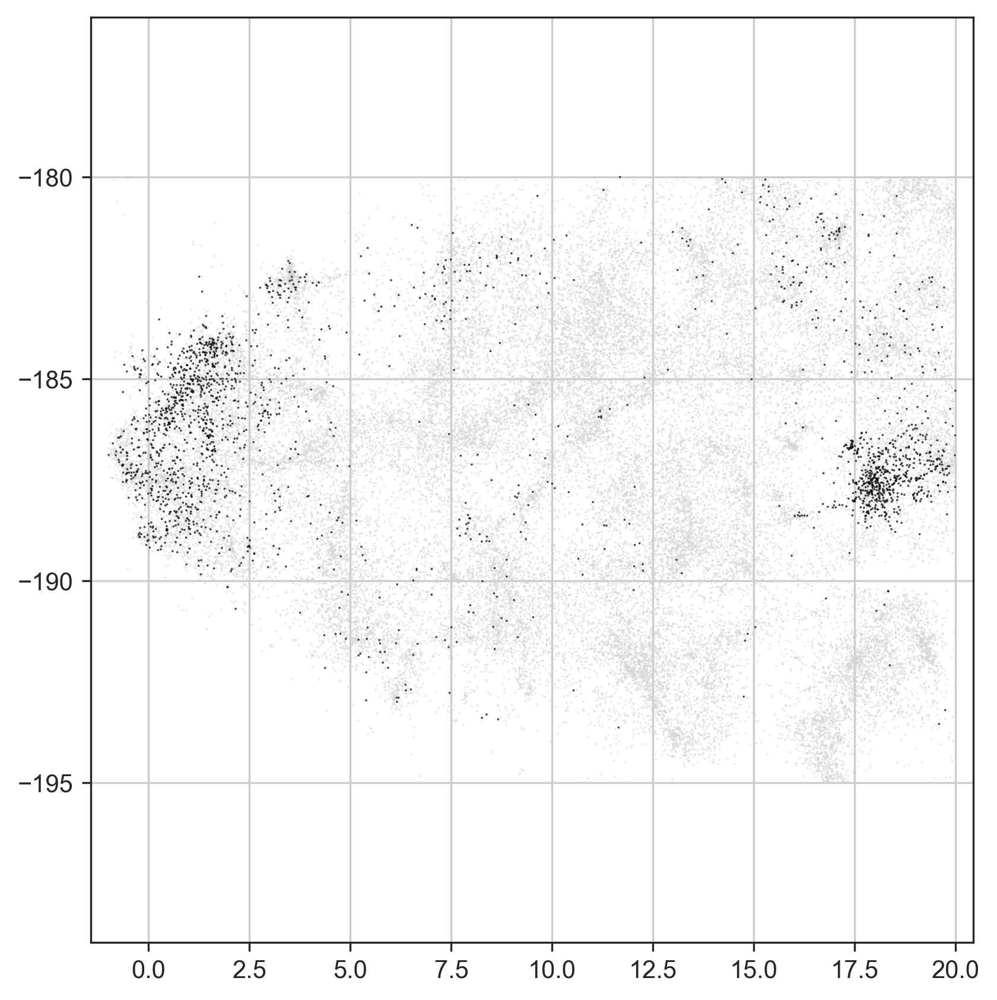

In [40]:
%%time
%matplotlib inline

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

right = 20
left = -1
top = -180
bottom = -195

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")
plot_tsne_zoom(
    tsne,
    mask_machine_learning,
    x_lim=(left, right),
    y_lim=(bottom, top),
    ax=ax,
    plot_type=None,
    axis_on=True,
)

In [73]:
#mask island 1
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=20
left=-1
top=-180
bottom=-195
mask_region_6=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom)

In [74]:
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_6, 20)

There are 43001 papers.
TF-IDF:  [0.0473292  0.04193929 0.04161105 0.04065828 0.03760978 0.03661121
 0.0329503  0.03100885 0.03053787 0.02999953 0.02896151 0.02801034
 0.02484634 0.02450807 0.02421688 0.02330285 0.02194636 0.02147702
 0.02119121 0.02075619]
Words:  ['the' 'of' 'and' 'information' 'data' 'to' 'medical' 'in' 'for' 'system'
 'health' 'is' 'systems' 'are' 'this' 'clinical' 'based' 'care' 'on' 'we']


In [75]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_6, 20)

For threshold = 0.05 ['information' 'the' 'data' 'medical' 'system' 'health' 'systems' 'paper'
 'clinical' 'of' 'care' 'research' 'and' 'based' 'patient' 'use' 'can'
 'we' 'electronic' 'technology']
For threshold = 0.10 ['information' 'medical' 'data' 'health' 'system' 'systems' 'care'
 'healthcare' 'computer' 'text' 'user' 'web' 'technology' 'research'
 'software' 'internet' 'electronic' 'biomedical' 'digital' 'knowledge']


In [76]:
#mask island 1
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=20
left=-1
top=-180
bottom=-195
mask_region_6_with_ml=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) & mask_machine_learning

In [77]:
%%time
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_6_with_ml, 20)

There are 2125 papers.
TF-IDF:  [0.12236997 0.1101425  0.04563677 0.04349398 0.04072636 0.04055488
 0.0365771  0.03607705 0.03481767 0.03288262 0.03267298 0.0310923
 0.03094217 0.0304554  0.02945711 0.02824602 0.02812018 0.02754829
 0.02684344 0.02581717]
Words:  ['machine' 'learning' 'data' 'the' 'of' 'and' 'to' 'ai' 'text' 'in'
 'intelligence' 'for' 'we' 'clinical' 'algorithms' 'medical' 'based'
 'information' 'artificial' 'is']
CPU times: user 246 ms, sys: 27 ms, total: 273 ms
Wall time: 270 ms


In [78]:
%%time
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_6_with_ml, 20)

For threshold = 0.05 ['machine' 'learning' 'data' 'clinical' 'medical' 'information' 'text'
 'based' 'algorithms' 'we' 'methods' 'artificial' 'intelligence'
 'research' 'performance' 'the' 'health' 'models' 'language' 'processing']
For threshold = 0.10 ['machine' 'learning' 'intelligence' 'text' 'ai' 'algorithms' 'data'
 'artificial' 'biomedical' 'nlp' 'medical' 'ml' 'classification'
 'healthcare' 'extraction' 'information' 'applications' 'models'
 'supervised' 'big']
CPU times: user 380 ms, sys: 28.7 ms, total: 409 ms
Wall time: 407 ms


### Region 7: cancer biomarkers

CPU times: user 517 ms, sys: 3.08 ms, total: 520 ms
Wall time: 520 ms


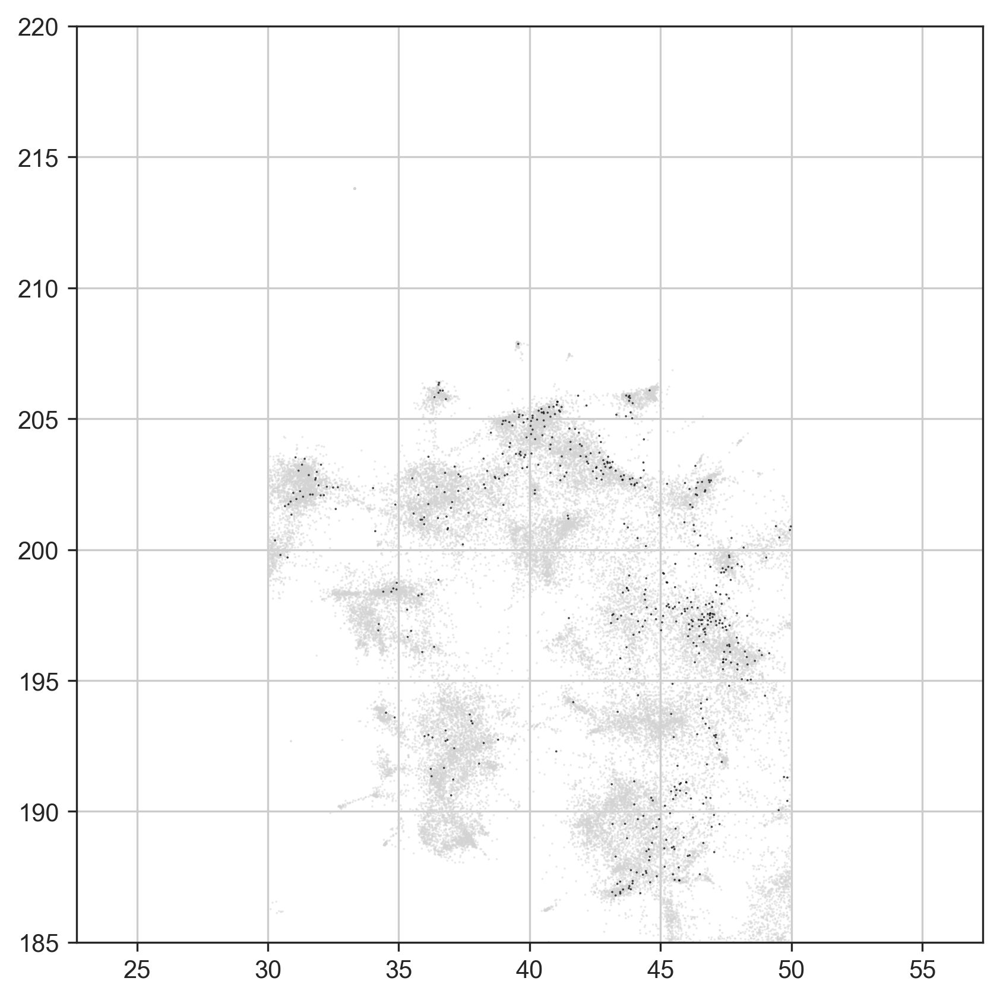

In [38]:
%%time
%matplotlib inline

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

right = 50
left = 30
top = 220
bottom = 185

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")
plot_tsne_zoom(
    tsne,
    mask_machine_learning,
    x_lim=(left, right),
    y_lim=(bottom, top),
    ax=ax,
    plot_type=None,
    axis_on=True,
)

In [57]:
#mask island 1
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=50
left=30
top=220
bottom=185
mask_region_4=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom)

In [58]:
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_4, 20)

There are 40810 papers.
TF-IDF:  [0.0633137  0.05924345 0.05086685 0.03998118 0.0394718  0.03890637
 0.0380521  0.03611152 0.03539742 0.03517994 0.03482893 0.03311867
 0.03302133 0.03231931 0.02978848 0.02899105 0.028904   0.02853131
 0.0278946  0.02750998]
Words:  ['cancer' 'expression' 'genes' 'and' 'the' 'gene' 'of' 'tumor' 'analysis'
 'in' 'mir' 'patients' 'prognostic' 'were' 'survival' 'to' 'prognosis'
 'identified' 'differentially' 'with']


In [59]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_4, 20)

For threshold = 0.05 ['expression' 'cancer' 'genes' 'gene' 'analysis' 'tumor' 'patients'
 'prognostic' 'prognosis' 'differentially' 'survival' 'biomarkers'
 'expressed' 'cell' 'identified' 'samples' 'tissues' 'carcinoma'
 'pathways' 'enrichment']
For threshold = 0.10 ['cancer' 'genes' 'expression' 'prognostic' 'mir' 'mirnas' 'tumor'
 'prognosis' 'tcga' 'mirna' 'degs' 'signature' 'immune' 'biomarkers'
 'gene' 'breast' 'differentially' 'survival' 'tissues' 'network']


In [60]:
#mask island 1
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=50
left=30
top=220
bottom=185
mask_region_4_with_ml=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) & mask_machine_learning

In [61]:
%%time
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_4_with_ml, 20)

There are 525 papers.
TF-IDF:  [0.10279529 0.08051092 0.06415593 0.04252407 0.04047072 0.03962503
 0.03901024 0.03791453 0.03759339 0.03698085 0.03509323 0.03486484
 0.03413285 0.03342678 0.03208311 0.03074082 0.03072086 0.03005113
 0.02893079 0.02891394]
Words:  ['machine' 'learning' 'cancer' 'genes' 'the' 'and' 'expression' 'gene'
 'of' 'biomarkers' 'prognostic' 'tumor' 'patients' 'we' 'to' 'survival'
 'in' 'based' 'prognosis' 'signature']
CPU times: user 234 ms, sys: 12 ms, total: 246 ms
Wall time: 244 ms


In [62]:
%%time
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_4_with_ml, 20)

For threshold = 0.05 ['machine' 'learning' 'cancer' 'genes' 'expression' 'patients'
 'biomarkers' 'gene' 'tumor' 'prognostic' 'prognosis' 'survival'
 'accuracy' 'validation' 'based' 'we' 'analysis' 'samples' 'genome'
 'model']
For threshold = 0.10 ['machine' 'cancer' 'learning' 'genes' 'prognostic' 'biomarkers' 'tcga'
 'immune' 'signature' 'tumor' 'prognosis' 'survival' 'prediction' 'svm'
 'signatures' 'validation' 'subtypes' 'classification' 'atlas' 'gene']
CPU times: user 135 ms, sys: 9.34 ms, total: 144 ms
Wall time: 142 ms


### Region 8 : protein structure

CPU times: user 476 ms, sys: 18 ms, total: 494 ms
Wall time: 494 ms


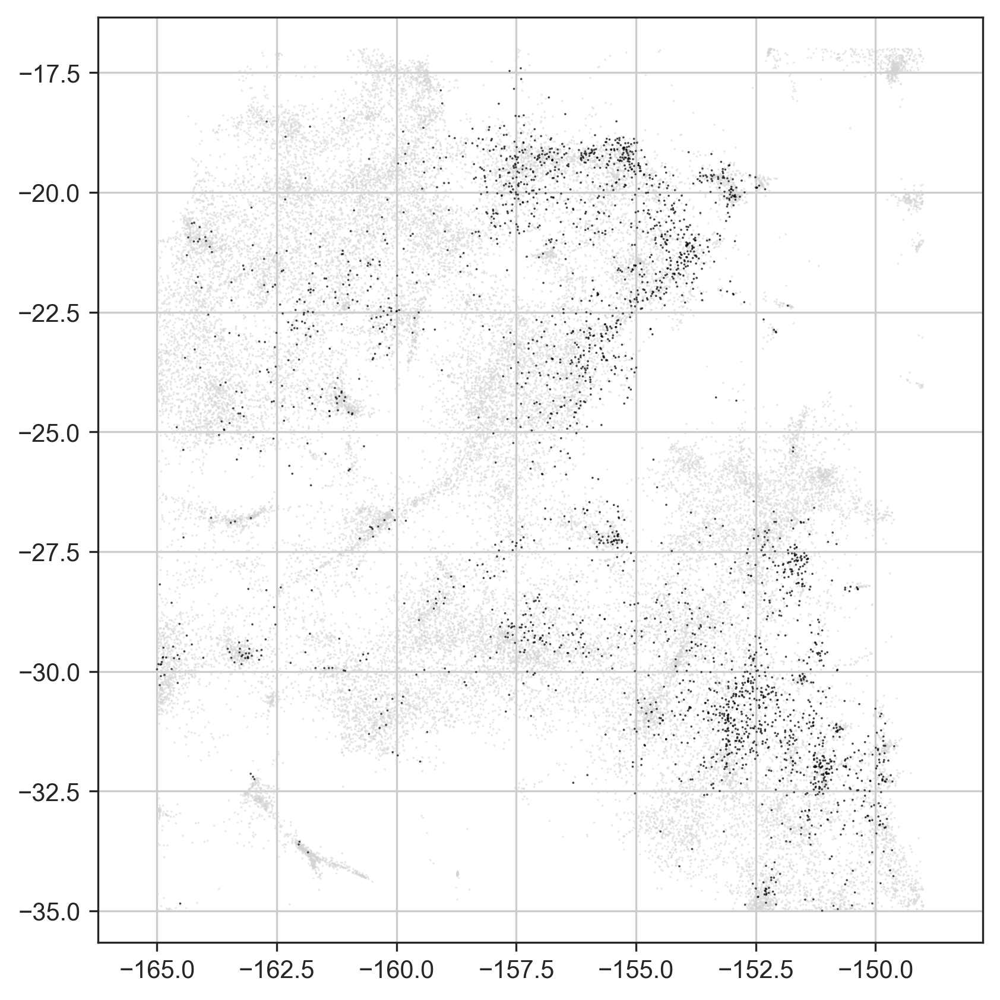

In [33]:
%%time
%matplotlib inline

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

right = -149
left = -165
top = -17
bottom = -35

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")
plot_tsne_zoom(
    tsne,
    mask_machine_learning,
    x_lim=(left, right),
    y_lim=(bottom, top),
    ax=ax,
    plot_type=None,
    axis_on=True,
)

In [283]:
#first
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=-149
left=-165
top=-17
bottom=-35
mask_region_1=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom)

In [23]:
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_1, 10)

There are 40059 papers.
TF-IDF:  [0.05038717 0.04765024 0.0441036  0.03795405 0.03673708 0.03403941
 0.03389006 0.03189849 0.03088475 0.03085496]
Words:  ['protein' 'the' 'of' 'structure' 'and' 'to' 'prediction' 'proteins' 'in'
 'for']


In [25]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_1, 10)

For threshold = 0.05 ['protein' 'the' 'structure' 'proteins' 'prediction' 'structures'
 'methods' 'of' 'structural' 'based']
For threshold = 0.10 ['protein' 'prediction' 'structure' 'proteins' 'structures' 'sequence'
 'binding' 'structural' 'ligand' 'computational']


In [26]:
#second
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=-149
left=-165
top=-17
bottom=-35
mask_region_1_with_ml=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) & mask_machine_learning

In [29]:
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_1_with_ml, 20)

There are 2648 papers.
TF-IDF:  [0.11702181 0.10049368 0.06443194 0.04479014 0.04428535 0.04163404
 0.04092527 0.03845924 0.03698555 0.0357743  0.03368022 0.03291613
 0.03174274 0.03057059 0.03036032 0.02903372 0.02810426 0.02795203
 0.02738329 0.0271927 ]
Words:  ['machine' 'learning' 'prediction' 'methods' 'the' 'protein' 'of' 'models'
 'and' 'based' 'to' 'we' 'for' 'in' 'accuracy' 'computational' 'structure'
 'is' 'model' 'set']


In [30]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_1_with_ml, 20)

For threshold = 0.05 ['machine' 'learning' 'prediction' 'methods' 'protein' 'models' 'accuracy'
 'based' 'set' 'computational' 'predict' 'structure' 'features'
 'performance' 'drug' 'sequence' 'method' 'model' 'we' 'proteins']
For threshold = 0.10 ['machine' 'learning' 'prediction' 'models' 'protein' 'descriptors'
 'methods' 'computational' 'sequence' 'svm' 'drug' 'compounds' 'set'
 'accuracy' 'proteins' 'feature' 'classification' 'features' 'algorithms'
 'structure']


### Region 9: computational chemistry

CPU times: user 508 ms, sys: 3.02 ms, total: 511 ms
Wall time: 511 ms


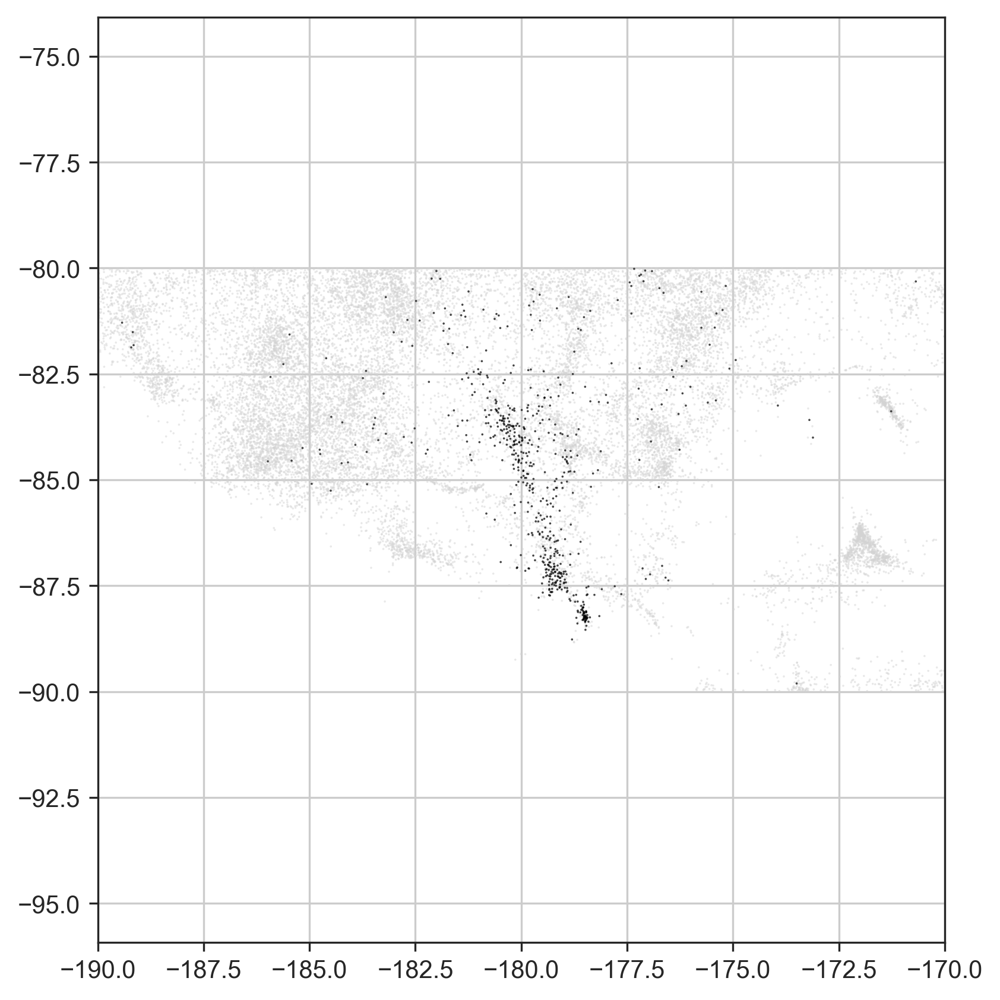

In [39]:
%%time
%matplotlib inline

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

right = -170
left = -190
top = -80
bottom = -90

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")
plot_tsne_zoom(
    tsne,
    mask_machine_learning,
    x_lim=(left, right),
    y_lim=(bottom, top),
    ax=ax,
    plot_type=None,
    axis_on=True,
)

In [65]:
#mask island 1
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=-170
left=-190
top=-80
bottom=-90
mask_region_5=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom)

In [66]:
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_5, 20)

There are 19690 papers.
TF-IDF:  [0.04817176 0.04103021 0.04037482 0.03557733 0.03557588 0.03407527
 0.03351193 0.03138639 0.03060201 0.03056057 0.03053104 0.03039163
 0.02870155 0.02790481 0.0274034  0.02704178 0.02416091 0.02232147
 0.0215524  0.02119697]
Words:  ['the' 'energy' 'of' 'calculations' 'energies' 'theory' 'and' 'density'
 'is' 'for' 'to' 'method' 'molecular' 'we' 'are' 'in' 'systems'
 'molecules' 'quantum' 'that']


In [67]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_5, 20)

For threshold = 0.05 ['energy' 'the' 'theory' 'calculations' 'density' 'method' 'molecular'
 'energies' 'systems' 'molecules' 'functional' 'we' 'approach' 'set'
 'methods' 'computational' 'accuracy' 'quantum' 'accurate' 'simulations']
For threshold = 0.10 ['energies' 'energy' 'calculations' 'theory' 'density' 'functionals' 'dft'
 'simulations' 'quantum' 'approximation' 'fock' 'method' 'hartree'
 'orbitals' 'initio' 'basis' 'atoms' 'molecules' 'electronic'
 'computational']


In [68]:
#mask island 1
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=-170
left=-190
top=-80
bottom=-90
mask_region_5_with_ml=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) & mask_machine_learning

In [69]:
%%time
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_5_with_ml, 20)

There are 619 papers.
TF-IDF:  [0.12032717 0.10822604 0.04534715 0.04530552 0.04183017 0.03855437
 0.0384689  0.03824395 0.03801161 0.03766524 0.03566106 0.03494872
 0.03457625 0.03384965 0.03282014 0.03280971 0.03230141 0.03205547
 0.03092099 0.03047015]
Words:  ['machine' 'learning' 'the' 'materials' 'of' 'we' 'energy' 'chemical'
 'energies' 'molecular' 'and' 'to' 'properties' 'models' 'for' 'accuracy'
 'computational' 'molecules' 'calculations' 'ml']
CPU times: user 244 ms, sys: 15.7 ms, total: 260 ms
Wall time: 256 ms


In [70]:
%%time
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_5_with_ml, 20)

For threshold = 0.05 ['machine' 'learning' 'energy' 'chemical' 'molecular' 'properties'
 'materials' 'accuracy' 'models' 'computational' 'we' 'molecules' 'theory'
 'approach' 'calculations' 'prediction' 'energies' 'set' 'density' 'the']
For threshold = 0.10 ['machine' 'learning' 'materials' 'energies' 'ml' 'energy' 'molecules'
 'atomic' 'dft' 'chemical' 'calculations' 'quantum' 'molecular'
 'descriptors' 'models' 'computational' 'accuracy' 'initio' 'prediction'
 'chemistry']
CPU times: user 138 ms, sys: 7.73 ms, total: 146 ms
Wall time: 143 ms


### Region 10: tumor imaging

CPU times: user 518 ms, sys: 5.67 ms, total: 524 ms
Wall time: 523 ms


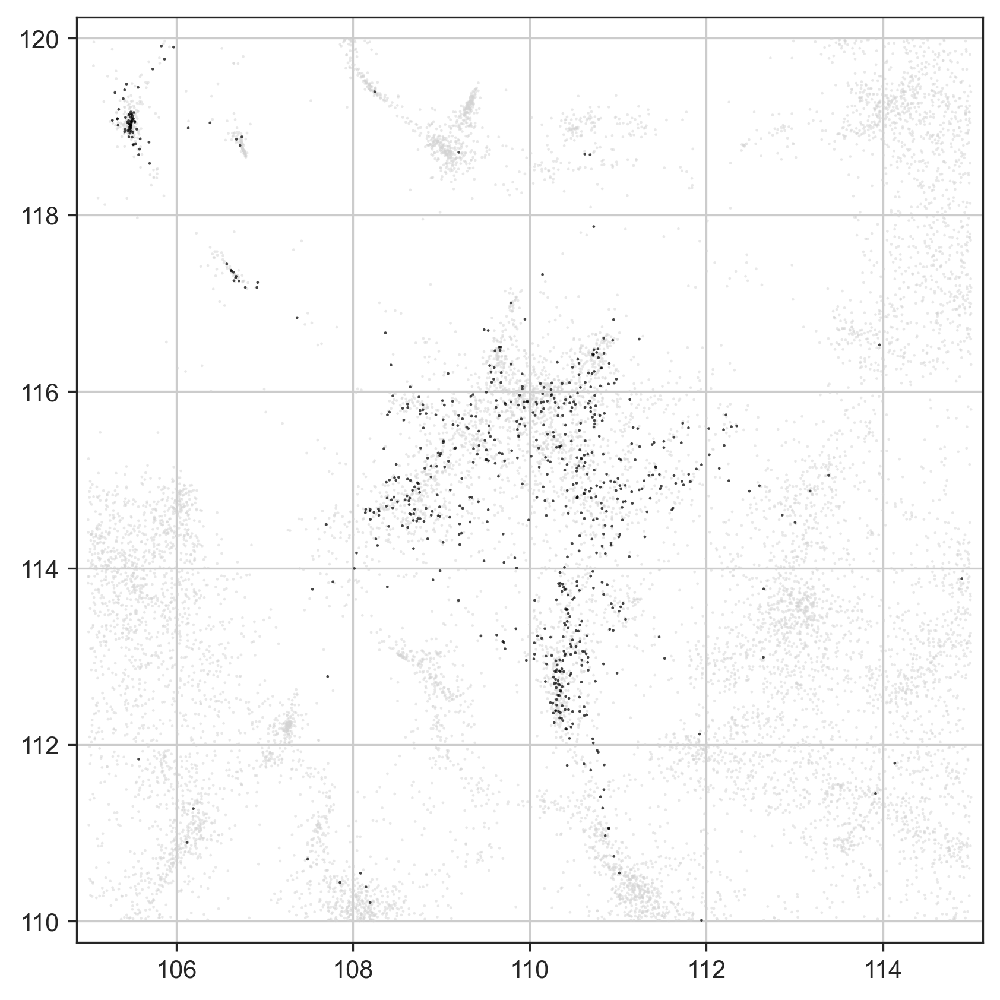

In [37]:
%%time
%matplotlib inline

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

right = 115
left = 105
top = 120
bottom = 110

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")
plot_tsne_zoom(
    tsne,
    mask_machine_learning,
    x_lim=(left, right),
    y_lim=(bottom, top),
    ax=ax,
    plot_type="zoom x2",
    axis_on=True,
)

In [47]:
#mask island 1
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=115
left=105
top=120
bottom=110
mask_region_3=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom)

In [48]:
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_3, 20)

There are 12504 papers.
TF-IDF:  [0.04906497 0.04850331 0.04687935 0.04351353 0.04124099 0.04033153
 0.03946127 0.03869068 0.03857945 0.03715246 0.03645159 0.03642595
 0.03218581 0.03135773 0.03104572 0.02996728 0.02990324 0.02973042
 0.0278559  0.02774544]
Words:  ['tumor' 'mri' 'patients' 'imaging' 'radiomics' 'pet' 'ct' 'the' 'and'
 'cancer' 'of' 'were' 'was' 'with' 'in' 'features' 'to' 'breast' 'for'
 'fdg']


In [49]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_3, 20)

For threshold = 0.05 ['patients' 'tumor' 'imaging' 'mri' 'cancer' 'ct' 'images' 'features'
 'pet' 'response' 'curve' 'tumors' 'breast' 'volume' 'tomography'
 'resonance' 'value' 'magnetic' 'predictive' 'predict']
For threshold = 0.10 ['mri' 'ct' 'tumor' 'pet' 'breast' 'radiomics' 'features' 'imaging' 'fdg'
 'auc' 'adc' 'cancer' 'radiomic' 'images' 'dce' 'tumors' 'diffusion'
 'validation' 'volume' 'response']


In [50]:
#mask island 1
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=115
left=105
top=120
bottom=110
mask_region_3_with_ml=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) & mask_machine_learning

In [51]:
%%time
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_3_with_ml, 20)

There are 696 papers.
TF-IDF:  [0.12310906 0.11708753 0.09405664 0.08320525 0.07521783 0.06731693
 0.04660663 0.04402501 0.04131416 0.04114046 0.04111235 0.04087538
 0.04027879 0.04023493 0.04015096 0.04005108 0.0400185  0.03928151
 0.03922702 0.03889913]
Words:  ['radiomics' 'machine' 'learning' 'features' 'radiomic' 'auc' 'validation'
 'model' 'performance' 'imaging' 'patients' 'mri' 'accuracy' 'ct'
 'feature' 'images' 'the' 'prediction' 'models' 'and']
CPU times: user 242 ms, sys: 20 ms, total: 262 ms
Wall time: 258 ms


In [52]:
%%time
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_3_with_ml, 20)

For threshold = 0.05 ['machine' 'learning' 'features' 'radiomics' 'auc' 'curve' 'validation'
 'extracted' 'images' 'accuracy' 'model' 'feature' 'performance'
 'prediction' 'models' 'patients' 'imaging' 'receiver' 'based' 'predict']
For threshold = 0.10 ['machine' 'radiomics' 'features' 'learning' 'auc' 'radiomic' 'ct' 'mri'
 'validation' 'prediction' 'texture' 'feature' 'classifier' 'images'
 'accuracy' 'imaging' 'classifiers' 'models' 'classification' 'set']
CPU times: user 172 ms, sys: 10.8 ms, total: 182 ms
Wall time: 179 ms


### Region 11: microbiome

CPU times: user 537 ms, sys: 939 µs, total: 538 ms
Wall time: 538 ms


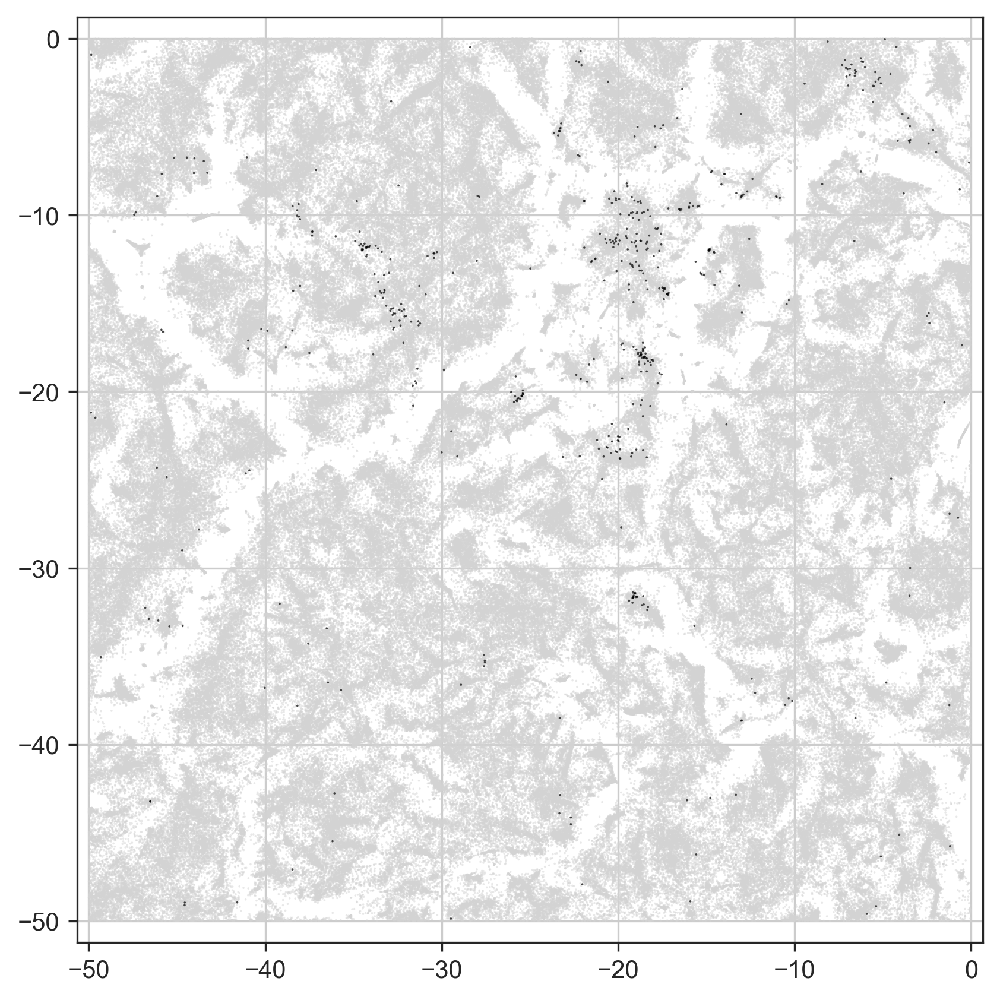

In [48]:
%%time
%matplotlib inline

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

right = 0
left = -50
top = 0
bottom = -50

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")
plot_tsne_zoom(
    tsne,
    mask_machine_learning,
    x_lim=(left, right),
    y_lim=(bottom, top),
    ax=ax,
    plot_type=None,
    axis_on=True,
)

CPU times: user 520 ms, sys: 1.84 ms, total: 522 ms
Wall time: 522 ms


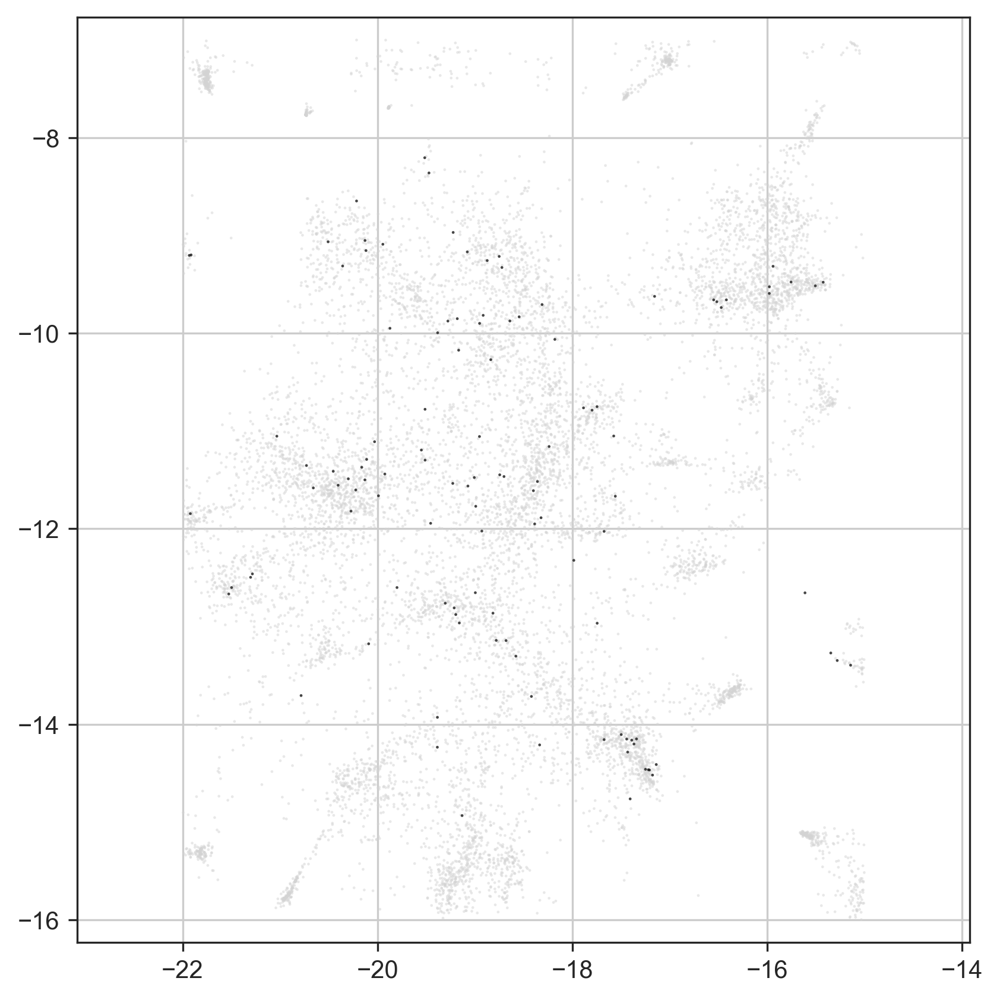

In [50]:
%%time
%matplotlib inline

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

right = -15
left = -22
top = -7
bottom = -16

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")
plot_tsne_zoom(
    tsne,
    mask_machine_learning,
    x_lim=(left, right),
    y_lim=(bottom, top),
    ax=ax,
    plot_type="zoom x2",
    axis_on=True,
)

In [226]:
#mask island 1
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=-15
left=-22
top=-7
bottom=-16
mask_region_11=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom)

In [227]:
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_11, 20)

There are 10729 papers.
TF-IDF:  [0.09713303 0.07119883 0.06369622 0.04680339 0.04250667 0.04164321
 0.04018229 0.0400103  0.0394444  0.03684155 0.03659117 0.03463216
 0.03361529 0.03327547 0.03158121 0.03150849 0.02966197 0.02959188
 0.02925021 0.02919126]
Words:  ['microbiota' 'gut' 'microbiome' 'microbial' 'the' 'bacterial' '16s' 'and'
 'of' 'diversity' 'in' 'composition' 'abundance' 'samples' 'fecal' 'were'
 'with' 'healthy' 'sequencing' 'rrna']


In [228]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_11, 20)

For threshold = 0.05 ['microbiota' '16s' 'gut' 'bacterial' 'microbial' 'sequencing'
 'composition' 'microbiome' 'diversity' 'rrna' 'abundance' 'samples'
 'healthy' 'patients' 'bacteria' 'fecal' 'intestinal' 'associated'
 'species' 'the']
For threshold = 0.10 ['microbiota' 'gut' 'microbiome' 'microbial' 'bacterial' 'diversity'
 'abundance' 'fecal' 'composition' 'bacteria' 'dysbiosis' 'healthy'
 'intestinal' 'firmicutes' 'prevotella' 'bacteroides' 'bacteroidetes'
 '16s' 'bifidobacterium' 'oral']


### Region 12: covid-19 tweets

CPU times: user 516 ms, sys: 3.6 ms, total: 519 ms
Wall time: 519 ms


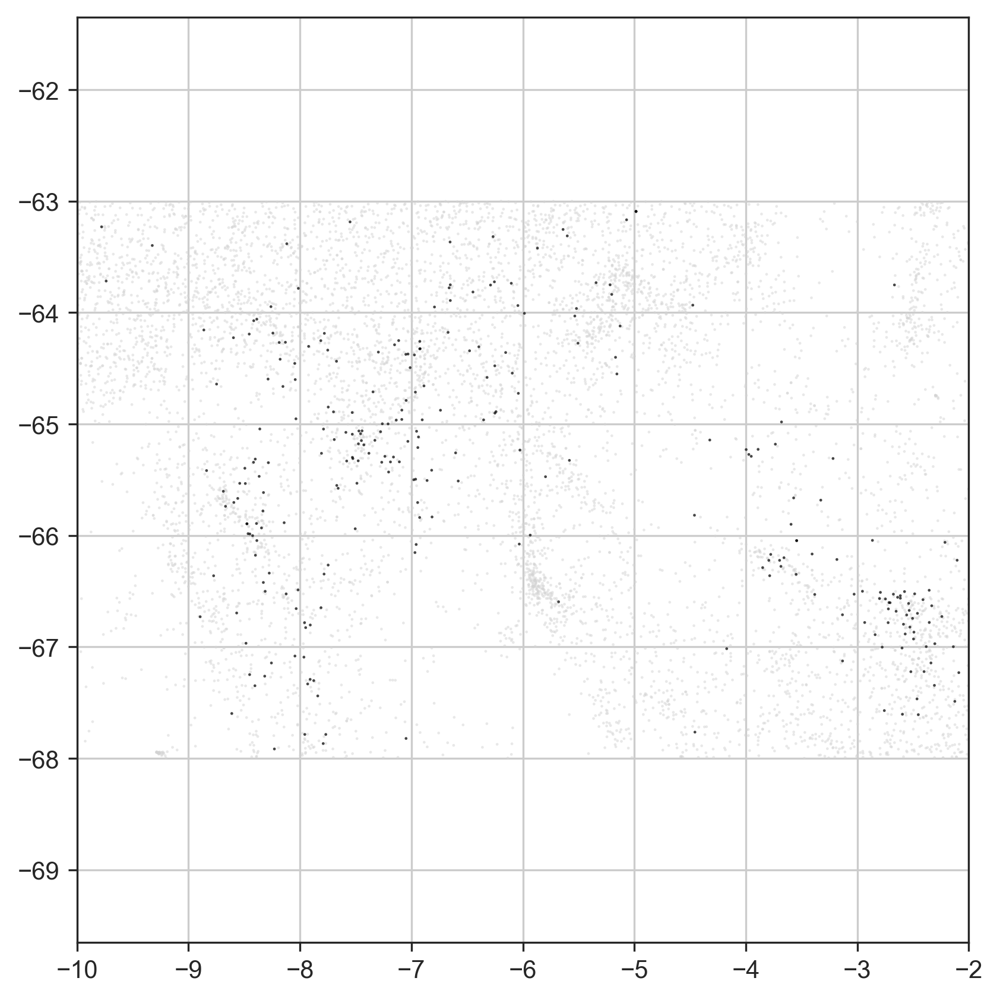

In [46]:
%%time
%matplotlib inline

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

right = -2
left = -10
top = -63
bottom = -68

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")
plot_tsne_zoom(
    tsne,
    mask_machine_learning,
    x_lim=(left, right),
    y_lim=(bottom, top),
    ax=ax,
    plot_type="zoom x2",
    axis_on=True,
)

In [186]:
#mask island 1
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=-2
left=-10
top=-63
bottom=-68
mask_region_10=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom)

In [187]:
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_10, 20)

There are 7383 papers.
TF-IDF:  [0.12003554 0.08008823 0.06742478 0.05035932 0.04302915 0.0398813
 0.03643299 0.03597974 0.03549622 0.03454548 0.03439916 0.03284794
 0.03245235 0.03230163 0.03225928 0.02944297 0.02932506 0.02924403
 0.02730241 0.02720688]
Words:  ['covid' '19' 'pandemic' 'the' 'of' 'and' 'to' 'spread' 'epidemic' 'in'
 'outbreak' 'data' 'cases' 'coronavirus' '2020' 'model' 'countries'
 'health' 'disease' 'we']


In [188]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_10, 20)

For threshold = 0.05 ['covid' '19' 'pandemic' 'the' 'spread' 'cases' 'data' '2020'
 'coronavirus' 'health' 'countries' 'model' 'outbreak' 'public' 'epidemic'
 'disease' 'we' 'measures' 'world' 'number']
For threshold = 0.10 ['covid' '19' 'pandemic' 'epidemic' 'outbreak' 'spread' '2020'
 'coronavirus' 'countries' 'cases' 'sars' 'lockdown' 'model' 'cov'
 'distancing' 'transmission' 'influenza' 'public' 'surveillance' 'deaths']


CPU times: user 515 ms, sys: 937 µs, total: 516 ms
Wall time: 516 ms


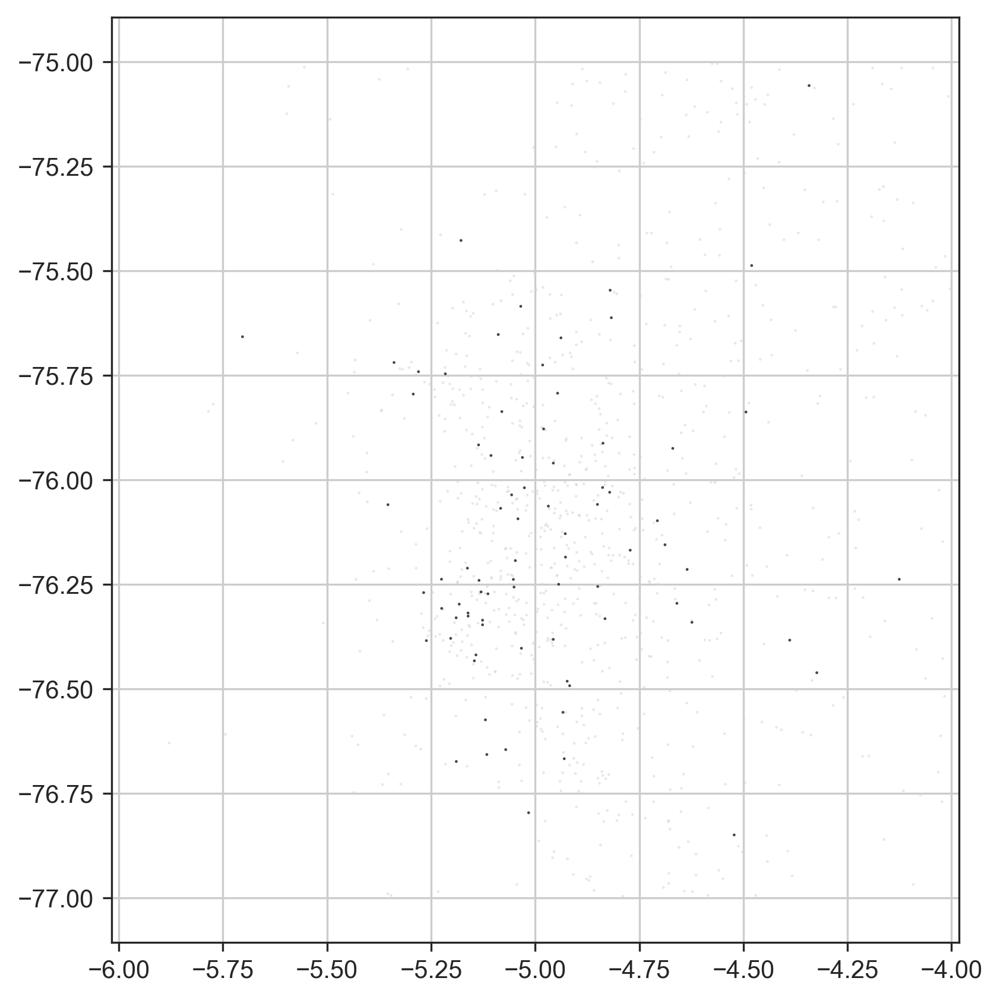

In [47]:
%%time
%matplotlib inline

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

right = -4
left = -6
top = -75
bottom = -77

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")
plot_tsne_zoom(
    tsne,
    mask_machine_learning,
    x_lim=(left, right),
    y_lim=(bottom, top),
    ax=ax,
    plot_type="zoom x2",
    axis_on=True,
)

In [181]:
#mask island 1
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=-4
left=-6
top=-75
bottom=-77
mask_region_10=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom)

In [182]:
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_10, 20)

There are 989 papers.
TF-IDF:  [0.11102285 0.08492151 0.07596151 0.07458935 0.07427682 0.06888108
 0.06868715 0.06105361 0.0463192  0.04340546 0.04282518 0.04237443
 0.04032078 0.03888775 0.0372453  0.0366176  0.03401265 0.03031705
 0.02971348 0.02969361]
Words:  ['covid' 'tweets' 'twitter' '19' 'pandemic' 'media' 'public' 'social'
 'health' 'news' 'the' '2020' 'information' 'sentiment' 'and' 'of' 'to'
 'on' 'posts' 'related']


In [183]:
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_10, 20)

For threshold = 0.05 ['covid' '19' 'media' 'public' 'pandemic' 'social' 'health' '2020'
 'twitter' 'information' 'tweets' 'news' 'coronavirus' 'related' 'users'
 'outbreak' 'content' 'online' 'about' 'topics']
For threshold = 0.10 ['covid' '19' 'twitter' 'pandemic' 'tweets' 'public' 'media' 'social'
 'news' 'sentiment' '2020' 'misinformation' 'posts' 'topics' 'outbreak'
 'users' 'information' 'vaccine' 'online' 'health']


In [39]:
#mask island 1
tsne=np.vstack((-tsne_reparsed[:,0], tsne_reparsed[:,1])).T
right=15
left=-15
top=-50
bottom=-85
mask_region_10_with_ml=(tsne[:,0]<right) & (tsne[:,0]>left) & (tsne[:,1]<top) & (tsne[:,1]>bottom) & mask_machine_learning

In [40]:
%%time
print_tfidf_top_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_10_with_ml, 20)

There are 859 papers.
TF-IDF:  [0.12459025 0.1095303  0.09320968 0.08303769 0.05124221 0.04458092
 0.03986427 0.03972971 0.03578289 0.03372408 0.03347604 0.03256869
 0.03085199 0.02883974 0.02861975 0.02845064 0.02721117 0.02633217
 0.02610159 0.0260606 ]
Words:  ['covid' 'machine' 'learning' '19' 'pandemic' 'the' 'and' 'of' 'to'
 'model' 'data' 'models' 'in' 'for' 'coronavirus' 'health' 'prediction'
 'disease' 'we' '2020']
CPU times: user 155 ms, sys: 3 ms, total: 158 ms
Wall time: 153 ms


In [41]:
%%time
print_tfidf_threshold_words(tfidf_features_updated_reparsed, vocabulary_swap, mask_region_10_with_ml, 20)

For threshold = 0.05 ['machine' 'learning' 'covid' '19' 'pandemic' 'model' 'models' 'data'
 'coronavirus' '2020' 'predict' 'health' 'prediction' 'the' 'patients'
 'accuracy' 'public' '2019' 'disease' 'based']
For threshold = 0.10 ['covid' '19' 'machine' 'learning' 'pandemic' 'prediction' 'models' 'sars'
 'coronavirus' 'cov' '2020' 'outbreak' 'model' 'forecasting' 'public'
 'predict' 'spread' 'mortality' 'twitter' 'social']
CPU times: user 119 ms, sys: 12.5 ms, total: 132 ms
Wall time: 128 ms


## Highlight regions in the global embedding

In [54]:
# top, bottom, left, right
square_coordinates = np.array(
    [
        [-17, -35, -165, -149],
        [-15, -37, -85, -70],
        [120, 110, 105, 115],
        [219, 185, 30, 50],
        [-80, -90, -190, -170],
        [-180, -195, -1, 20],
        [-150, -175, -60, -40],
        [-115, -130, -37, -10],
        [-95, -110, -25, 0],
        [-75, -77, -6, -4],
        [-7, -16, -22, -15],
        [-42, -56, -117, -99],
    ]
)

print(square_coordinates.shape)

(12, 4)


In [55]:
region_labels = [
    "protein structure",
    "sequencing ",
    "tumor imaging",
    "cancer biomarkers",
    "computational chemistry",
    "healthcare data",
    "ML algorithms",
    "eeg signals",
    "image segmentation",
    "covid-19 tweets",
    "microbiome",
    "mass spectometry",
]

In [56]:
region_labels_numbers = {
    "protein structure": 8,
    "sequencing ": 2,
    "tumor imaging": 10,
    "cancer biomarkers": 7,
    "computational chemistry": 9,
    "healthcare data": 6,
    "ML algorithms": 4,
    "eeg signals": 1,
    "image segmentation": 3,
    "covid-19 tweets": 12,
    "microbiome": 11,
    "mass spectometry": 5,
}
region_labels_numbers

{'protein structure': 8,
 'sequencing ': 2,
 'tumor imaging': 10,
 'cancer biomarkers': 7,
 'computational chemistry': 9,
 'healthcare data': 6,
 'ML algorithms': 4,
 'eeg signals': 1,
 'image segmentation': 3,
 'covid-19 tweets': 12,
 'microbiome': 11,
 'mass spectometry': 5}

Number of papers with uncapitalized word 'machine learning':  36692
Number of papers with capitalized word 'machine learning':  3849
Number of total papers with word 'machine learning':  38446
CPU times: user 58.3 s, sys: 6.63 s, total: 1min 4s
Wall time: 1min 5s


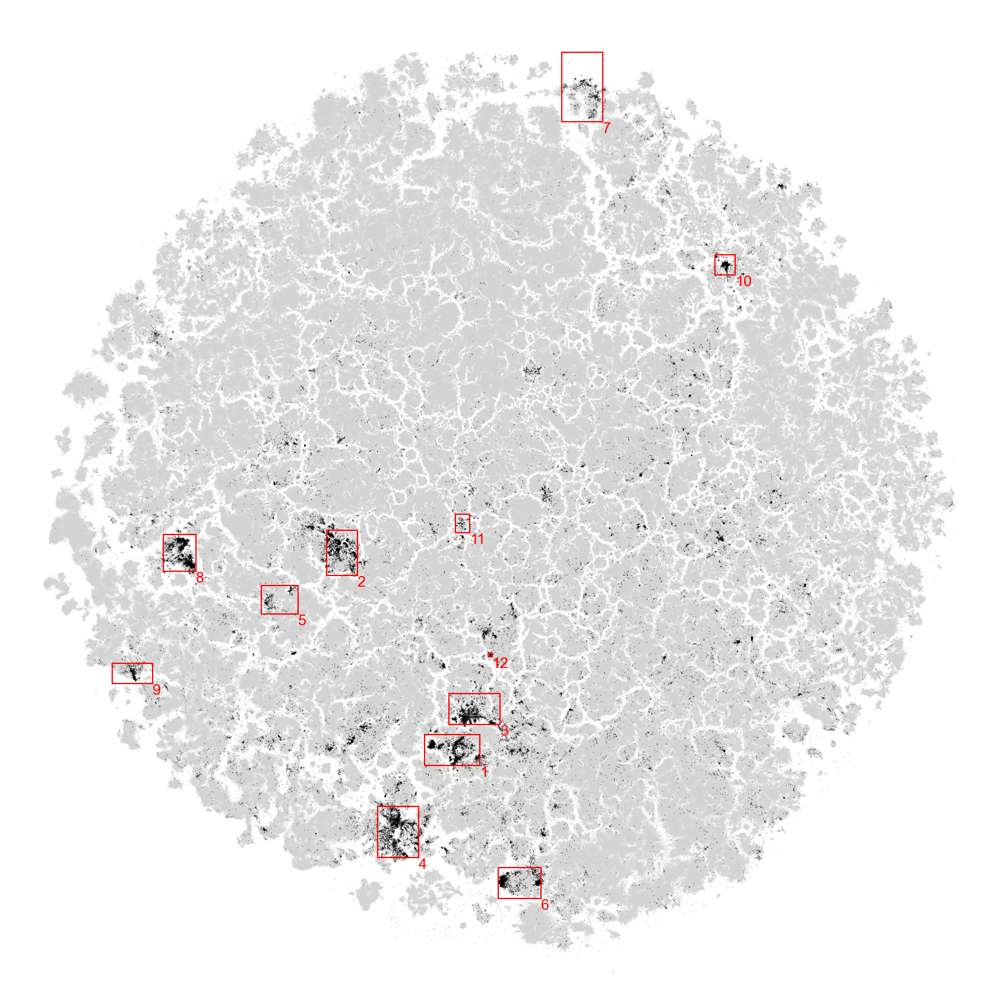

In [63]:
%%time
%matplotlib inline

tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

x_lim = (-230, 230)
y_lim = (-230, 230)

fig, ax = plt.subplots(figsize=(5.5, 5.5), dpi=300, layout="constrained")
plot_tsne_word(
    all_abstracts,
    "machine learning",
    tsne,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    title_on=False,
    axis_on=False,
)

for i in range(square_coordinates.shape[0]):
    plot_square(square_coordinates[i], lw=0.5)

plot_region_names(square_coordinates, ax1, region_labels, fontsize=5)
plot_region_numbers(
    square_coordinates, ax1, region_labels, region_labels_numbers
)

fig.savefig(figures_path / 'tsne_machine_learning_with_regions.png')

# Heatmap machine learning methods in each region

## Import

In [31]:
# import clean_df_updated
clean_df_updated_reparsed_filtered_with_authors_ISSN = pd.read_pickle(
    variables_path / "clean_df_updated_reparsed_filtered_with_authors_ISSN"
)

tcmalloc: large alloc 1073741824 bytes == 0x93caa8000 @ 
tcmalloc: large alloc 1233903616 bytes == 0x9e6a28000 @ 


In [32]:
tsne_reparsed = np.load(variables_path / "bert/tsne_reparsed.npy")

In [25]:
# top, bottom, left, right
square_coordinates = np.array(
    [
        [-17, -35, -165, -149],
        [-15, -37, -85, -70],
        [120, 110, 105, 115],
        [219, 185, 30, 50],
        [-80, -90, -190, -170],
        [-180, -195, -1, 20],
        [-150, -175, -60, -40],
        [-115, -130, -37, -10],
        [-95, -110, -25, 0],
        [-75, -77, -6, -4],
        [-7, -16, -22, -15],
        [-42, -56, -117, -99],
    ]
)

print(square_coordinates.shape)

(12, 4)


In [27]:
# load
# legend colors
pickle_in = open(variables_path / "ml_legend.pkl", "rb")
ml_legend = pickle.load(pickle_in)

# ml colors
ml_colors = np.load(variables_path / "ml_colors.npy", allow_pickle=True)

In [29]:
words_to_search = ml_legend.keys()

## Calculation

In [33]:
%%time

tnse = tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T
(
    counts_ml_words,
    fraction_ml_words,
    size_regions,
) = counts_and_fraction_words_in_red_squares(
    square_coordinates,
    tsne,
    clean_df_updated_reparsed_filtered_with_authors_ISSN.AbstractText,
    words_to_search,
)

Region  1
Region  2
Region  3
Region  4
Region  5
Region  6
Region  7
Region  8
Region  9
Region  10
Region  11
Region  12
CPU times: user 16.5 s, sys: 261 ms, total: 16.8 s
Wall time: 16.8 s


In [44]:
np.save(variables_path / 'counts_ml_words', counts_ml_words)
np.save(variables_path / 'fraction_ml_words', fraction_ml_words)
np.save(variables_path / 'ml_words_columns', list(words_to_search))
np.save(variables_path / 'size_regions', size_regions)

## Plot

In [11]:
#counts_ml_words = np.load(variables_path / 'counts_ml_words.npy')
#ml_words_columns = np.load(variables_path / 'ml_words_columns.npy')
#size_regions = np.load(variables_path / 'size_regions.npy')

In [34]:
fraction_ml_words = counts_ml_words / size_regions.reshape(-1, 1)

In [35]:
percentage_ml_words = fraction_ml_words * 100

In [37]:
x_labels = np.array(
    ["RF", "NN", "CNN", "LR", "Clustering", "DR", "SVM", "FA", "PCA", "DL"]
)

y_labels = np.array(
    [
        "Region 1: protein, prediction, structure, sequence, binding",
        "Region 2: gene, genome, sequencing, network, database",
        "Region 3: mri, ct, tumor, pet, breast",
        "Region 4: cancer, genes, expression, prognostic, mir",
        "Region 5: energy, calculations, theory, density, functionals",
        "Region 6: information, medical, data, health, system",
        "Region 7: algorithm, network, proposed, learning, problem",
        "Region 8: eeg, signals, hearing, classification, speech",
        "Region 9: images, segmentation, algorithm, method, proposed",
        "Region 10: covid, 19, twitter, pandemic, tweets",
        "Region 11: microbiota, gut, microbiome, bacterial, diversity",
        "Region 12: ms, mass, spectrometry, method, compounds",
    ]
)

region_labels = [
    "protein structure",
    "sequencing ",
    "tumor imaging",
    "cancer biomarkers",
    "computational chemistry",
    "healthcare data",
    "ML algorithms",
    "eeg signals",
    "image segmentation",
    "covid-19 tweets",
    "microbiome",
    "mass spectometry",
]

region_labels = np.array([elem.capitalize() for elem in region_labels])

In [46]:
# GOOD
sorted_columns = np.flip(np.argsort(np.mean(percentage_ml_words, axis=0)))
sorted_column_labels = np.hstack((0, x_labels[sorted_columns]))

sorted_region = np.flip(np.argsort(size_regions))
sorted_region_labels = region_labels[sorted_region]

sorted_percentage_ml_words = percentage_ml_words[sorted_region, :]
sorted_percentage_ml_words = sorted_percentage_ml_words[:, sorted_columns]


table = np.vstack(
    (
        sorted_column_labels,
        np.hstack(
            (
                sorted_region_labels.reshape(-1, 1),
                sorted_percentage_ml_words.round(1),
            )
        ),
    )
)

for i in range(table.shape[0]):
    print(table[i])

['0' 'NN' 'Clustering' 'DL' 'SVM' 'CNN' 'PCA' 'RF' 'LR' 'DR' 'FA']
['Eeg signals' '6.1' '1.7' '1.9' '3.3' '2.1' '1.1' '0.8' '0.8' '0.4' '0.2']
['Sequencing ' '1.5' '5.8' '1.0' '0.9' '0.7' '0.4' '0.6' '0.3' '0.3' '0.1']
['Image segmentation' '9.5' '2.4' '7.3' '2.5' '7.6' '0.9' '1.0' '0.5'
 '0.2' '0.1']
['Ml algorithms' '14.7' '5.7' '4.3' '2.9' '5.1' '1.1' '0.6' '0.5' '0.9'
 '0.2']
['Mass spectometry' '1.8' '1.2' '0.2' '1.5' '0.2' '4.9' '0.4' '1.1' '0.2'
 '0.5']
['Healthcare data' '1.7' '0.8' '1.6' '0.6' '0.6' '0.0' '0.2' '0.0' '0.0'
 '0.0']
['Cancer biomarkers' '0.5' '4.9' '0.2' '1.0' '0.1' '1.1' '0.8' '0.3' '0.1'
 '0.1']
['Protein structure' '5.5' '3.5' '1.9' '4.6' '1.0' '0.7' '1.7' '1.4' '0.3'
 '0.1']
['Computational chemistry' '1.9' '0.4' '0.3' '0.1' '0.2' '0.1' '0.1' '0.2'
 '0.1' '0.0']
['Tumor imaging' '3.3' '1.2' '2.8' '3.6' '2.0' '0.7' '2.6' '1.3' '0.3'
 '0.1']
['Microbiome' '0.1' '2.9' '0.0' '0.2' '0.0' '1.2' '1.5' '0.9' '0.0' '0.1']
['Covid-19 tweets' '1.5' '2.1' '1.9' '0.7' '0

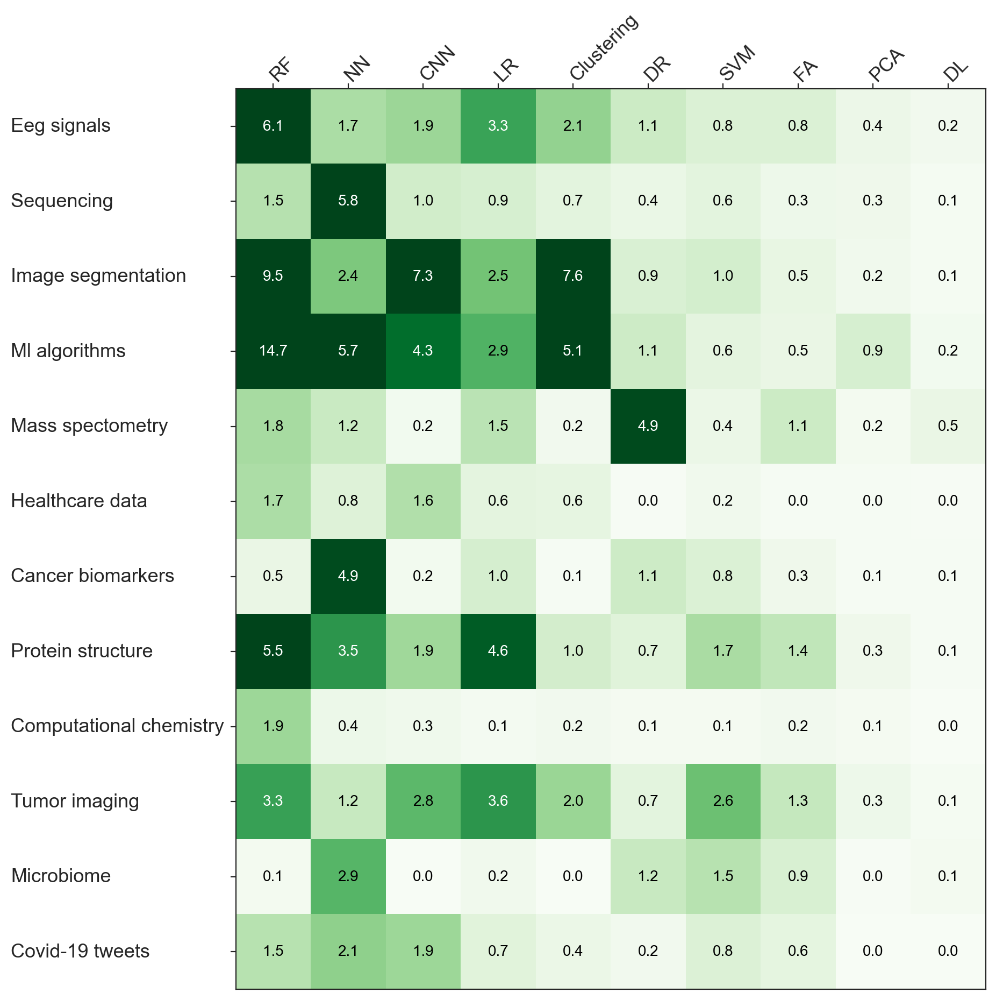

In [48]:
%matplotlib inline
fig = plt.figure(figsize=(9, 12), dpi=200)
ax = plt.gca()

ax.imshow(sorted_percentage_ml_words, cmap="Greens", vmax=5)

ax.set_xticks(np.arange(0, sorted_percentage_ml_words.shape[1]))
ax.set_xticklabels(x_labels, fontsize=13)
ax.set_yticks(np.arange(0, sorted_percentage_ml_words.shape[0]))
ax.set_yticklabels([])
#
# Set ticks on both sides of axes on
ax.tick_params(
    axis="x", bottom=False, top=True, labelbottom=False, labeltop=True
)
# Rotate and align bottom ticklabels
plt.setp(
    [tick.label1 for tick in ax.xaxis.get_major_ticks()],
    rotation=45,
    ha="right",
    va="center",
    rotation_mode="anchor",
)
# Rotate and align top ticklabels
plt.setp(
    [tick.label2 for tick in ax.xaxis.get_major_ticks()],
    rotation=45,
    ha="left",
    va="center",
    rotation_mode="anchor",
)

y = np.arange(0, sorted_percentage_ml_words.shape[0])

for i in y:
    plt.text(
        -3.5,
        y[i],
        sorted_region_labels[i],
        ha="left",
        va="center",
        fontsize=13,
    )

for i in np.arange(len(sorted_region_labels)):
    for j in np.arange(len(x_labels)):
        if sorted_percentage_ml_words[i, j] > 3:
            plt.text(
                j,
                i,
                "{:.1f}".format(sorted_percentage_ml_words[i, j]),
                ha="center",
                va="center",
                color="w",
            )
        else:
            plt.text(
                j,
                i,
                "{:.1f}".format(sorted_percentage_ml_words[i, j]),
                ha="center",
                va="center",
                color="black",
            )

# fig.savefig(figures_path / 'heatmap_ml_words.png')

# Percentage of papers mentioning 'machine learning' in their abstracts across time for different disciplines. 
(cancer, cardiology, dermatology, gynecology, neurology, ophthalmology, psychiatry, radiology, surgery)

## Import

In [13]:
# save results
colors_new = np.load(variables_path / "colors_new.npy", allow_pickle=True)

In [12]:
pickle_in = open(variables_path / "colors_new_legend.pkl", "rb")
colors_new_legend = pickle.load(pickle_in)

In [12]:
# save
date_year = np.load(variables_path / "date_year_reparsed.npy")

In [13]:
# import clean_df_updated
clean_df_updated_reparsed_filtered_with_authors_ISSN = pd.read_pickle(variables_path / "clean_df_updated_reparsed_filtered_with_authors_ISSN")

tcmalloc: large alloc 1073741824 bytes == 0x8d4e6a000 @ 
tcmalloc: large alloc 1233903616 bytes == 0x97eedc000 @ 


In [14]:
all_abstracts = clean_df_updated_reparsed_filtered_with_authors_ISSN['AbstractText']

## Calculation

In [19]:
%%time

labels = ['cancer', 'radiology', 'dermatology', 'cardiology', 'neurology', 'ophthalmology', 'surgery', 
                   'anesthesiology', 'gynecology', 'pediatric', 'rehabilitation', 'psychiatry', 'pathology']

years = np.arange(2010,2022)

X_years_labels = {}
y_ml_labels = {}
fraction_ml_labels = {}
number_papers_labels = {}

for label in labels:
    print(label)
    
    abstracts_label = all_abstracts[colors_new == colors_new_legend[label]]
    date_year_label = date_year[colors_new == colors_new_legend[label]]

    X_years, y_ml, fraction_ml, number_papers = get_ml_per_year(years, abstracts_label, date_year_label, verbose=False)
    
    X_years_labels[label] = X_years
    y_ml_labels[label] = y_ml
    fraction_ml_labels[label] = fraction_ml
    number_papers_labels[label] = number_papers
    

cancer
radiology
dermatology
cardiology
neurology
ophthalmology
surgery
anesthesiology
gynecology
pediatric
rehabilitation
psychiatry
pathology
CPU times: user 11.9 s, sys: 987 ms, total: 12.9 s
Wall time: 12.9 s


In [65]:
# save results
f = open(variables_path / "fraction_ml_labels.pkl","wb")
pickle.dump(fraction_ml_labels,f)
f.close()

In [21]:
# save results
f = open(variables_path / "X_years_labels.pkl","wb")
pickle.dump(X_years_labels,f)
f.close()

## Fitting a Generalized Additive Model (GAM)

In [45]:
%%time

gam_plotting_results = pd.DataFrame(index = ['XX', 'pdep', 'confi', 'intercept'])

for label in labels:
    print(label)
    
    X_years = X_years_labels[label]
    y_ml = y_ml_labels[label]
    
    gam = train_logistic_gam(X_years, y_ml, verbose=True)
    
    XX, pdep, confi, intercept = get_plot_gam(gam, 'logistic')
    
    gam_plotting_results[label] = [XX, pdep, confi, intercept]
    

cancer


100% (20 of 20) |########################| Elapsed Time: 0:00:12 Time:  0:00:12
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:303: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      2.0026
Link Function:                        LogitLink Log Likelihood:                                 -2994.3121
Number of Samples:                       170228 AIC:                                             5992.6294
                                                AICc:                                            5992.6295
                                                UBRE:                                               2.0352
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0887
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:03 Time:  0:00:03
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:303: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      4.6892
Link Function:                        LogitLink Log Likelihood:                                 -2241.5237
Number of Samples:                        52081 AIC:                                             4492.4258
                                                AICc:                                            4492.4273
                                                UBRE:                                               2.0863
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.1001
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:03 Time:  0:00:03
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:303: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      2.3565
Link Function:                        LogitLink Log Likelihood:                                  -243.0268
Number of Samples:                        40501 AIC:                                              490.7667
                                                AICc:                                             490.7674
                                                UBRE:                                               2.0122
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0673
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:04 Time:  0:00:04
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:303: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      2.0005
Link Function:                        LogitLink Log Likelihood:                                  -663.8913
Number of Samples:                        55564 AIC:                                             1331.7836
                                                AICc:                                             1331.784
                                                UBRE:                                                2.024
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.1083
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:05 Time:  0:00:05
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:303: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      3.6103
Link Function:                        LogitLink Log Likelihood:                                 -1266.9021
Number of Samples:                        62933 AIC:                                             2541.0247
                                                AICc:                                            2541.0256
                                                UBRE:                                               2.0404
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0734
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:04 Time:  0:00:04
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:303: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      5.9004
Link Function:                        LogitLink Log Likelihood:                                  -693.5843
Number of Samples:                        54419 AIC:                                             1398.9694
                                                AICc:                                            1398.9714
                                                UBRE:                                               2.0258
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0736
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:18 Time:  0:00:18
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:303: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()
  5% (1 of 20) |#                        | Elapsed Time: 0:00:00 ETA:  00:00:00

LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      2.0376
Link Function:                        LogitLink Log Likelihood:                                 -1633.9618
Number of Samples:                       228264 AIC:                                             3271.9988
                                                AICc:                                            3271.9989
                                                UBRE:                                               2.0143
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0903
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:303: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      4.7537
Link Function:                        LogitLink Log Likelihood:                                   -56.1559
Number of Samples:                         6990 AIC:                                               121.819
                                                AICc:                                             121.8301
                                                UBRE:                                                2.018
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.1848
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:02 Time:  0:00:02
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:303: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      2.0001
Link Function:                        LogitLink Log Likelihood:                                  -150.4884
Number of Samples:                        26968 AIC:                                              304.9771
                                                AICc:                                              304.978
                                                UBRE:                                               2.0114
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0831
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:07 Time:  0:00:07
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:303: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      2.0005
Link Function:                        LogitLink Log Likelihood:                                  -645.9543
Number of Samples:                        99984 AIC:                                             1295.9095
                                                AICc:                                            1295.9098
                                                UBRE:                                                2.013
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0864
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:02 Time:  0:00:02
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:303: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      2.0013
Link Function:                        LogitLink Log Likelihood:                                  -782.1524
Number of Samples:                        35604 AIC:                                             1568.3076
                                                AICc:                                            1568.3082
                                                UBRE:                                               2.0441
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0461
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:05 Time:  0:00:05
/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:303: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      2.0026
Link Function:                        LogitLink Log Likelihood:                                 -1831.8631
Number of Samples:                        67551 AIC:                                             3667.7314
                                                AICc:                                            3667.7318
                                                UBRE:                                               2.0543
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.0715
Feature Function                  Lam

100% (20 of 20) |########################| Elapsed Time: 0:00:05 Time:  0:00:05


LogisticGAM                                                                                               
=============================================== ==========================================================
Distribution:                      BinomialDist Effective DoF:                                      2.0007
Link Function:                        LogitLink Log Likelihood:                                  -780.3452
Number of Samples:                        65432 AIC:                                             1564.6918
                                                AICc:                                            1564.6922
                                                UBRE:                                               2.0239
                                                Scale:                                                 1.0
                                                Pseudo R-Squared:                                   0.1092
Feature Function                  Lam

/gpfs01/berens/user/rgonzalesmarquez/phd/biomedical-landscape/src/gam.py:303: UserWarning: KNOWN BUG: p-values computed in this summary are likely much smaller than they should be. 
 
Please do not make inferences based on these values! 

Collaborate on a solution, and stay up to date at: 
github.com/dswah/pyGAM/issues/163 

  gam.summary()


In [51]:
# save
gam_plotting_results.to_pickle(variables_path / "gam_fraction_ml_labels_plotting_results")

## Plot

In [8]:
# load
gam_plotting_results = pd.read_pickle(
    variables_path / "gam_fraction_ml_labels_plotting_results"
)

In [9]:
gam_plotting_results_T = gam_plotting_results.transpose()

In [16]:
pickle_in = open(variables_path / "X_years_labels.pkl", "rb")
X_years_labels = pickle.load(pickle_in)

In [17]:
pickle_in = open(variables_path / "fraction_ml_labels.pkl", "rb")
fraction_ml_labels = pickle.load(pickle_in)

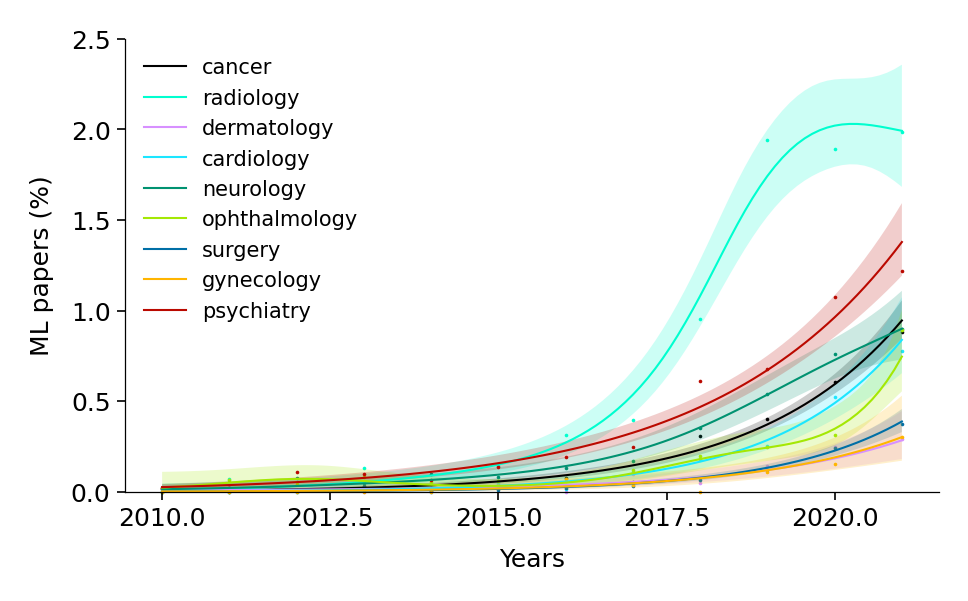

In [21]:
%matplotlib inline

labels = [
    "cancer",
    "radiology",
    "dermatology",
    "cardiology",
    "neurology",
    "ophthalmology",
    "surgery",
    "anesthesiology",
    "gynecology",
    "pediatric",
    "rehabilitation",
    "psychiatry",
    "pathology",
]

with plt.style.context("matplotlib_style.txt"):
    fig, ax = plt.subplots(figsize=(3.5, 2), dpi=300)
    excluded_labels = [
        "anesthesiology",
        "rehabilitation",
        "pathology",
        "pediatric",
    ]
    for label in labels:
        if label in excluded_labels:
            continue

        ax.plot(
            gam_plotting_results_T.XX[label][:, 0],
            (gam_plotting_results_T.pdep[label]) * 100,
            c=colors_new_legend[label],
            label=label,
        )

        ax.fill_between(
            gam_plotting_results_T.XX[label][:, 0],
            (gam_plotting_results_T.confi[label])[:, 1] * 100,
            (gam_plotting_results_T.confi[label])[:, 0] * 100,
            color=colors_new_legend[label],
            alpha=0.2,
            edgecolor=None,
        )

        ax.scatter(
            np.unique(X_years_labels[label]),
            np.array(fraction_ml_labels[label]) * 100,
            c=colors_new_legend[label],
            marker=".",
            s=3,
            clip_on=False,
            linewidths=0,
        )

    # ax.set_xlim(left=2010, right=2022)
    ax.set_ylim(bottom=0)
    ax.set_yticks([0.0, 0.5, 1.0, 1.5, 2.0, 2.5])
    ax.legend(fontsize=5)
    ax.set_xlabel("Years")
    ax.set_ylabel("ML papers (%)")

    # fig.savefig(figures_path / 'gam_fraction_ml.png', facecolor='white')